In [2]:
import datetime
import os
from collections import OrderedDict
from sys import stdout
from utils import *
from PIL import Image
from keras.engine.topology import Input
from keras.engine.training import Model
from keras.layers.advanced_activations import LeakyReLU
from keras.layers.convolutional import Conv2DTranspose, Convolution2D
from keras.layers.core import Dense, Reshape, Activation, Dropout, Flatten
from keras.layers.noise import GaussianNoise
from keras import backend as K

import numpy as np

import matplotlib.pyplot as plt
from keras.layers.merge import Concatenate, concatenate
from keras.layers.normalization import BatchNormalization
from keras.losses import binary_crossentropy
from keras.initializers import RandomNormal
from keras.optimizers import Adam
import theano.tensor as T
from dataset import get_dataset, get_center, save_image

SEED=1994


In [3]:
init = RandomNormal(mean=0.0, stddev=0.02, seed=SEED)

def make_generator(input_size=100):
    """
    Return a model for the generator.
    This model take a random noise in parameter and generate
    :return:
    """

    features = [(512, 5, 2), (256, 5, 2), (128, 5, 2)]

    input = Input(shape=(input_size,), name="input_z")

    _out = Dense(units=1024 * 4 * 4, kernel_initializer=RandomNormal(mean=0.0, stddev=0.02, seed=SEED))(input)

    _out = BatchNormalization(momentum=.9)(_out)
    _out = Activation('relu')(_out)

    _out = Reshape((1024, 4, 4))(_out)

    for f, kernel, strides in features:
        _out = Conv2DTranspose(filters=f,
                               kernel_size=5,
                               strides=2,
                               padding="same",
                               data_format="channels_first",
                               kernel_initializer=RandomNormal(mean=0.0, stddev=0.02, seed=SEED))(_out)
        _out = BatchNormalization(axis=1, momentum=.9)(_out)
        _out = Activation('relu')(_out)

    _out = Conv2DTranspose(filters=3,
                           kernel_size=5,
                           padding="same",
                           activation='tanh',
                           data_format="channels_first",
                           kernel_initializer=RandomNormal(mean=0.0, stddev=0.02, seed=SEED))(_out)

    model = Model(input, _out)
    return model


def make_discriminator(dropout_rate=0.5):
    features = [(256, 5, 2), (512, 5, 2), (1024, 5, 2)]

    _input = Input(shape=(3, 32, 32))

    _out = _input
    _out = GaussianNoise(stddev=.1)(_out)

    _out = Convolution2D(filters=128,
                         kernel_size=5,
                         padding='same',
                         strides=2,
                         data_format="channels_first")(_out)

    _out = LeakyReLU(alpha=0.2)(_out)

    for f,  kernel, strides in features:
        _out = Convolution2D(filters=f,
                             kernel_size=5,
                             padding='same',
                             strides=2,
                             data_format="channels_first")(_out)

        _out = BatchNormalization(axis=1, momentum=.9)(_out)
        _out = LeakyReLU(alpha=0.2)(_out)

        _out = Dropout(rate=dropout_rate)(_out)

    _out = Flatten()(_out)

    # _out = Dense(1000)(_out)
    # _out = BatchNormalization()(_out)
    #
    # _out = LeakyReLU()(_out)
    #
    _out = Dropout(rate=dropout_rate)(_out)

    _out = Dense(1, activation='sigmoid')(_out)

    model = Model(_input, _out)

    return model

def set_trainable(m, v):
    for l in m.layers:
        l.trainable = v


noise_size = 100

In [4]:
from keras.models import Sequential, load_model
from keras.optimizers import Adam

discriminator = None
generator = None
discriminator_on_generator = None

def init_model():
    global discriminator, generator, discriminator_on_generator

    generator = make_generator()

    discriminator = make_discriminator()

    discriminator_on_generator = Sequential()
    discriminator_on_generator.add(generator)
    set_trainable(discriminator, False)
    discriminator_on_generator.add(discriminator)


    # custom hp for Adam as in the paper on training GAN tips
    discriminator_on_generator.compile(loss='binary_crossentropy', optimizer=Adam(lr=.0002, beta_1=.5))

    generator.compile(loss='mse', optimizer='sgd')

    set_trainable(discriminator, True)
    discriminator.compile(loss='binary_crossentropy', optimizer=Adam(lr=.0002, beta_1=.5))
    
def load_saved_model():
    gen_file, dis_file = sorted((e for e in os.listdir('.') if e.endswith(("_discriminator.h5","_generator.h5"))), reverse=True)[0:2]
    print("Discriminator: %s\nGenerator: %s"%(dis_file, gen_file))
    
    global discriminator, generator, discriminator_on_generator
    
    generator = load_model(gen_file)
    discriminator = load_model(dis_file)
    
    discriminator_on_generator = Sequential()
    discriminator_on_generator.add(generator)
    set_trainable(discriminator, False)
    discriminator_on_generator.add(discriminator)

    # custom hp for Adam as in the paper on training GAN tips
    discriminator_on_generator.compile(loss='binary_crossentropy', optimizer=Adam(lr=.0002, beta_1=.5))

    

In [13]:
init_model()
# load_saved_model()

set_trainable(discriminator, False)
set_trainable(generator, True)
discriminator_on_generator.summary()
generator.summary()

set_trainable(discriminator, True)
set_trainable(generator, False)
discriminator.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
model_3 (Model)              (None, 3, 32, 32)         18937603  
_________________________________________________________________
model_4 (Model)              (None, 1)                 17225985  
Total params: 36,163,588.0
Trainable params: 18,903,043.0
Non-trainable params: 17,260,545.0
_________________________________________________________________
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_z (InputLayer)         (None, 100)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 16384)             1654784   
_________________________________________________________________
batch_normalization_8 (Batch (None, 16384)             65536     
_________________________________________________

In [14]:
data = get_center(get_dataset(80000, 0, 0, min=-1., max=1.)[0])


dataset/inpainting/train2014/*.jpg


In [15]:
BATCH_SIZE = 32
STEP_PER_EPOCH = data.shape[0] // BATCH_SIZE
NOISE_SIZE = 100
start = True

print("Batch size: %d\nStep per epoch: %d\nNoise size: %d\nDataset shape: %s"%(BATCH_SIZE, STEP_PER_EPOCH, NOISE_SIZE, str(data.shape)))

Batch size: 32
Step per epoch: 2500
Noise size: 100
Dataset shape: (80000, 3, 32, 32)


In [16]:
def batch_noise():
    return (np.random.normal(loc=0, scale=1, size=(BATCH_SIZE, NOISE_SIZE)),
            [1.] * BATCH_SIZE)

def batch_dataset(step_nb):
    assert step_nb < STEP_PER_EPOCH
    
    return (data[step_nb * BATCH_SIZE:(step_nb + 1) * BATCH_SIZE, :, :, :],
            [.9] * BATCH_SIZE)

def batch_generator():    
    return (generator.predict_on_batch(batch_noise()[0]), 
            [0.] * BATCH_SIZE)


In [17]:
import progressbar as pb
from progressbar.widgets import FormatWidgetMixin, WidthWidgetMixin

class TextBar(FormatWidgetMixin, WidthWidgetMixin):
    mapping = {}

    def __init__(self, format, mapping=mapping, **kwargs):
        self.format = format
        self.mapping = mapping
        FormatWidgetMixin.__init__(self, format=format, **kwargs)
        WidthWidgetMixin.__init__(self, **kwargs)

    def update_mapping(self, mapping):
        self.mapping = mapping

    def __call__(self, progress, data, format=None):
        return FormatWidgetMixin.__call__(self, progress, self.mapping,
                                          self.format)

def progress_bar(title):
    loss_display = TextBar(format="loss: %.4f", mapping=0.)

    bar = pb.ProgressBar(widgets=[
                title, '[', loss_display,'] ',
                pb.Percentage(), ' ',
                pb.Bar(), ' ',
                pb.Timer(),
            ])
    
    bar.update_loss = lambda l: loss_display.update_mapping(l)
    return bar

def mixed_progress_bar():
    loss_display_d = TextBar(format="loss_d: %.4f", mapping=0.)
    loss_display_g = TextBar(format="loss_g: %.4f", mapping=0.)
    mode = TextBar(format='Training %s...', mapping='D')
    
    bar = pb.ProgressBar(widgets=[
            mode,
            '[', loss_display_d,'/ ', loss_display_g, '] ',
            
            pb.Percentage(), ' ',
            pb.Bar(), ' ',
            pb.Timer(),
        ])
    
    bar.update_loss = lambda l, discriminator: loss_display_d.update_mapping(l) if discriminator \
                                                else loss_display_g.update_mapping(l)
    bar.set_mode = lambda d: mode.update_mapping('D' if d else 'G')
    
    return bar



In [18]:
mean_loss_g = 0.
mean_loss_d = 0.

    
def epoch_generator(scale=1.):
    set_trainable(discriminator, False)
    global mean_loss_g
    
    loss = []
    steps = int(STEP_PER_EPOCH * scale)

    bar = progress_bar("Training Generator *%.2f"%scale)
    for i in bar(range(steps)):
        loss_g = discriminator_on_generator.train_on_batch(*batch_noise())
        loss.append(loss_g)
        
        mean_loss_g = 0.95 * mean_loss_g + 0.05 * loss_g
        
        bar.update_loss(mean_loss_g)
        
    return loss, mean_loss_g

def epoch_discriminator(scale=1.):
    np.random.shuffle(data)
    loss = []
    global mean_loss_d
    
    steps = int(STEP_PER_EPOCH * scale)
    
    set_trainable(discriminator, True)
    bar = progress_bar("Training Discriminator *%.2f"%scale)
    
    for i in bar(range(steps)):
        
        _b_f = batch_generator()
        _b_t = batch_dataset(i)
        
        loss_d_0 = discriminator.train_on_batch(*_b_f)
        loss_d_1 = discriminator.train_on_batch(*_b_t)
        
        loss_d = loss_d_0 + loss_d_1
        loss.append(loss_d)
        
        mean_loss_d = 0.95 * mean_loss_d + 0.05 * loss_d

        bar.update_loss(mean_loss_d)
        
    return loss, mean_loss_d


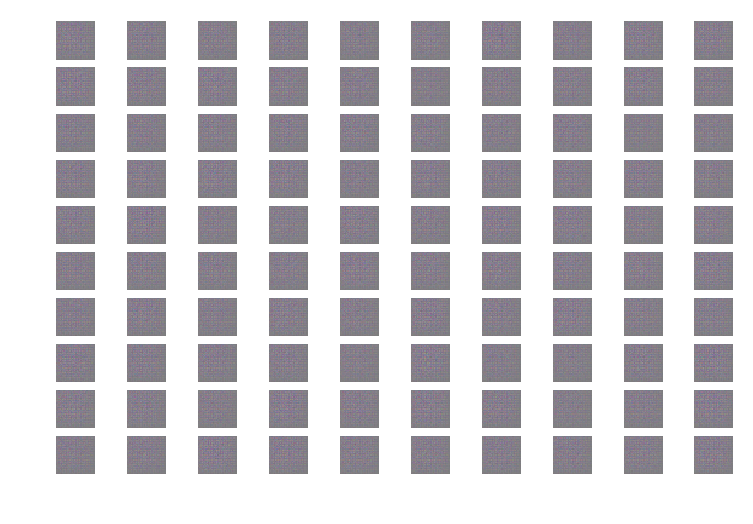

In [19]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.gridspec as gridspec

def display_imgs(imgs):
    n = imgs.shape[0]
    assert n <= 100
    
    fig = plt.figure(dpi=150)

    for i in range(n):
        sb_plot = fig.add_subplot(10, 10, i + 1)
        sb_plot.imshow(imgs[i, :, :, :])
        sb_plot.axis('off')
    plt.show()

# imgs = (data[0:100, :, :,:] / 2. + 0.5).transpose(0, 2,3,1)

def display_gen_output():
    imgs = generator.predict_on_batch(np.random.normal(loc=0, scale=1., size=(100, NOISE_SIZE)))
    imgs = (imgs / 2. + 0.5).transpose(0, 2,3,1)
    display_imgs(imgs)

display_gen_output()


In [20]:
losses = {'g': [], 'd': []}

def train_model(nb_epoch):
    global start
    if start:
        for i in range(3):
            losses['d'] += epoch_discriminator()
        start = False
    
    
    for i in range(nb_epoch):
        print("---- Epoch %d ----"%i, flush=True)
        
        l_g, m_l_g = epoch_generator()
            
        losses['g'] += l_g
        
        l_d, m_l_d = epoch_discriminator()    

        losses['d'] += l_d
        
        display_gen_output()


In [21]:
def clean_loss(loss):
    res = {}
    for e in ('g', 'd'):
        res[e] = [v for i, v in enumerate(loss[e]) if v < .60]
    return res


def display_loss():
    loss = clean_loss(losses)
    
    f = plt.figure(dpi=150)
    
    plt.plot(np.linspace(0., 1., len(loss['g'])), loss['g'], label="Generator loss")
    plt.plot(np.linspace(0., 1., len(loss['d'])), loss['d'], label="Discriminator loss")
    plt.legend()
    plt.show()


In [22]:
# losses['g'] += epoch_generator()[0]


In [23]:
def strategy_train(epoch, min_loss_g=.02, min_loss_d=.35, max_pass=3):
    
    mean_loss_d = None
    mean_loss_g = None
    
    for i in range(epoch):
        print("---- Step %d ----"%i, flush=True)
        
        for j in range(max_pass):
            l_d, mean_loss_d = epoch_discriminator(1.0)   
            losses['d'] += l_d
            
            if mean_loss_d < min_loss_d:
                break

        
        for j in range(max_pass):
            l_g, mean_loss_g = epoch_generator(.6)
            losses['g'] += l_g
            display_gen_output()
            
            if mean_loss_g < min_loss_g:
                break
        
        display_loss()


---- Step 0 ----


Training Discriminator *1.00[loss: 0.3270] 100% |#######| Elapsed Time: 0:18:55
Training Generator *0.60[loss: 0.0397] 100% |###########| Elapsed Time: 0:08:02


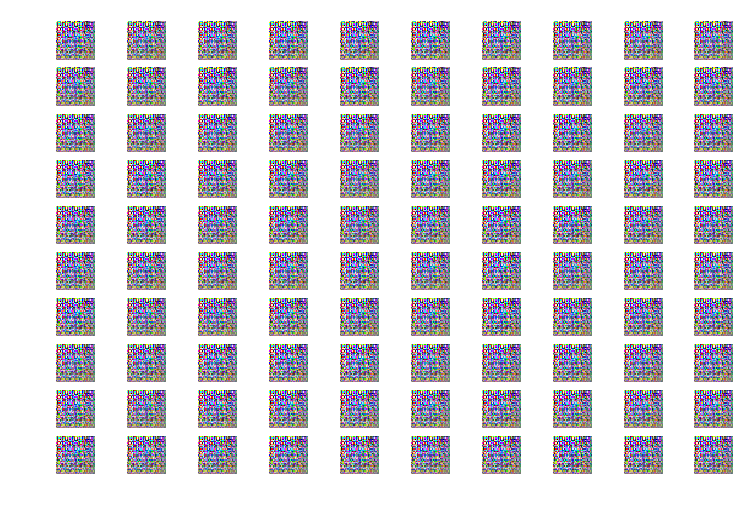

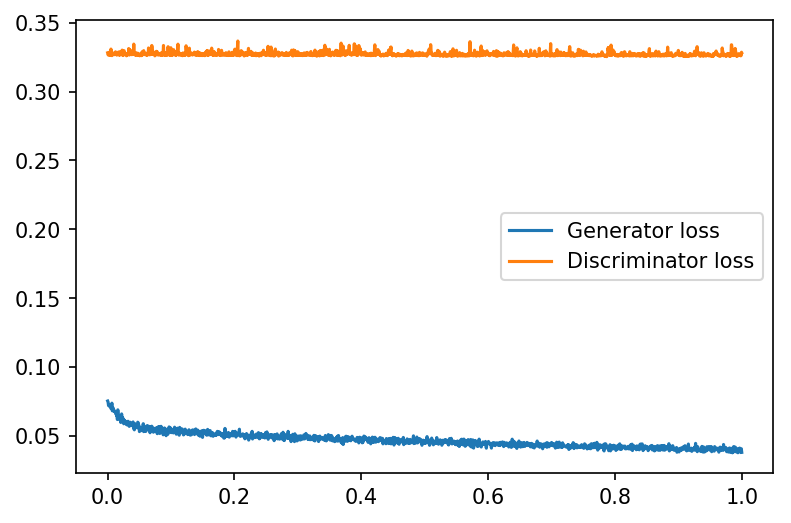

---- Step 1 ----


Training Discriminator *1.00[loss: 0.3268] 100% |#######| Elapsed Time: 0:18:54
Training Generator *0.60[loss: 0.0593] 100% |###########| Elapsed Time: 0:07:48


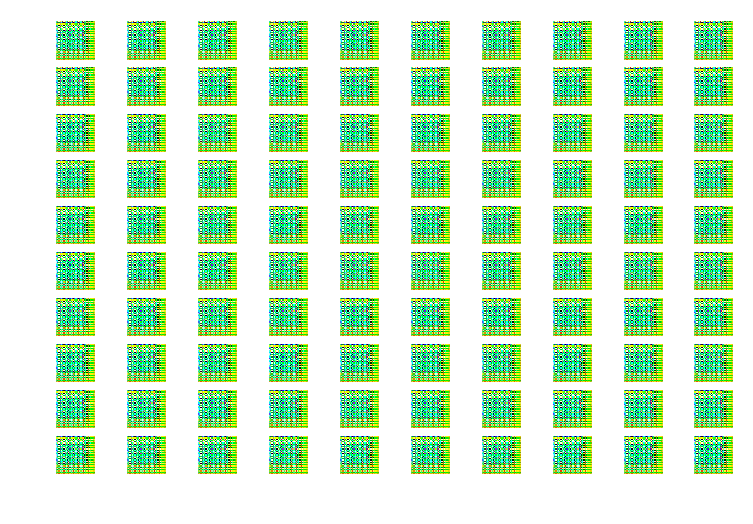

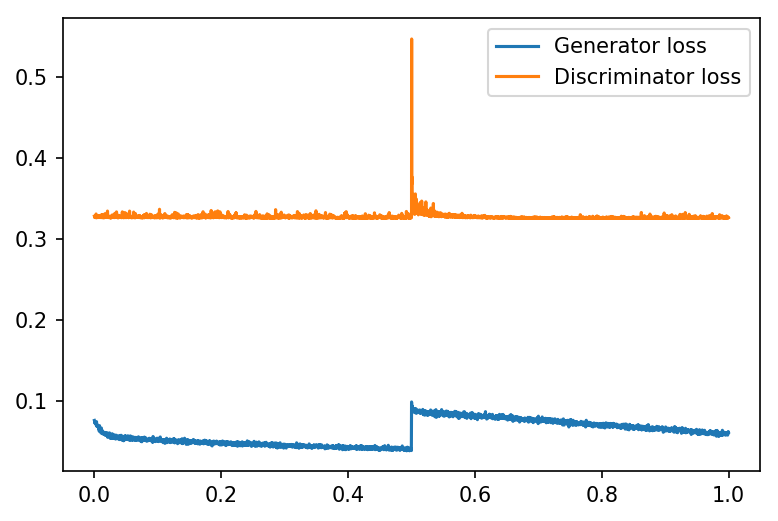

---- Step 2 ----


Training Discriminator *1.00[loss: 0.3264] 100% |#######| Elapsed Time: 0:18:54
Training Generator *0.60[loss: 0.0786] 100% |###########| Elapsed Time: 0:07:48


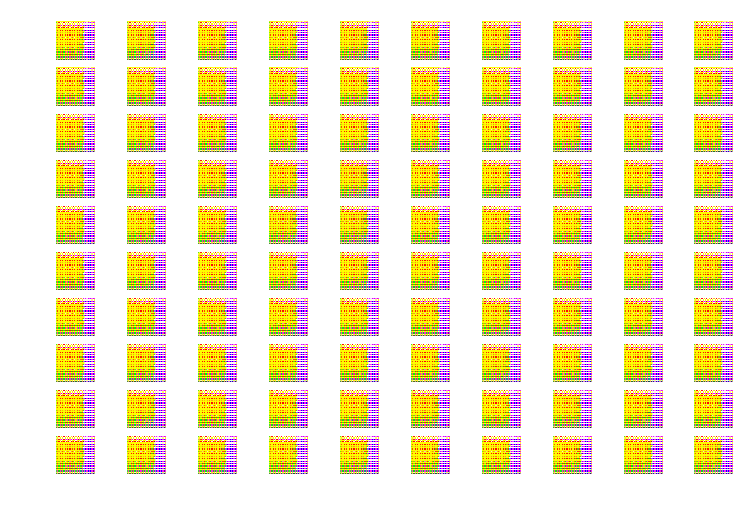

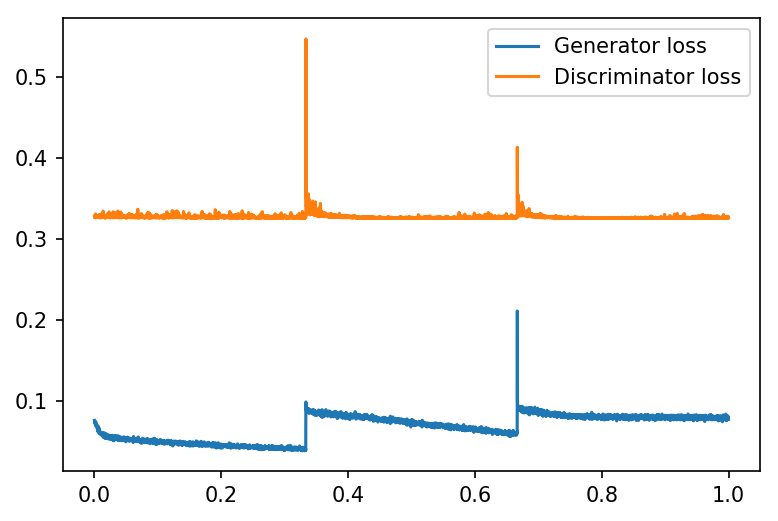

---- Step 3 ----


Training Discriminator *1.00[loss: 0.3260] 100% |#######| Elapsed Time: 0:18:54
Training Generator *0.60[loss: 0.0651] 100% |###########| Elapsed Time: 0:07:47


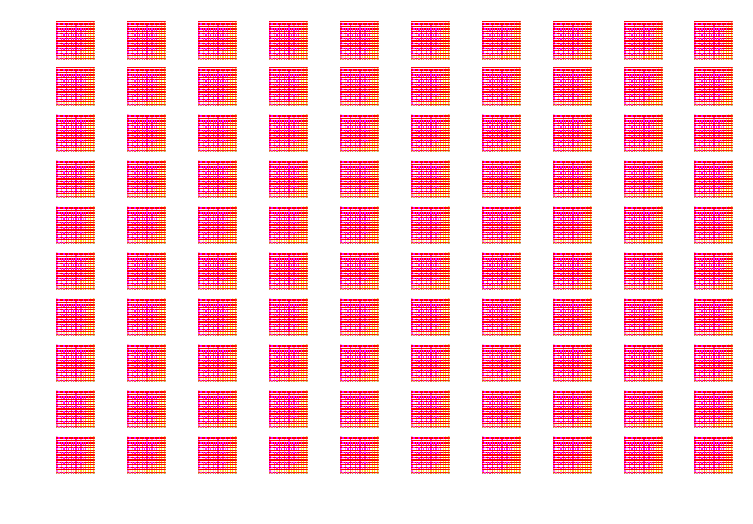

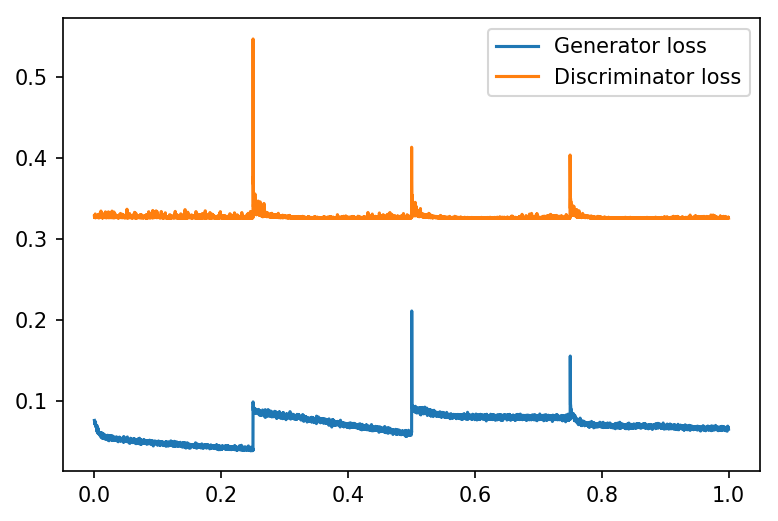

---- Step 4 ----


Training Discriminator *1.00[loss: 0.3259] 100% |#######| Elapsed Time: 0:18:54
Training Generator *0.60[loss: 0.0440] 100% |###########| Elapsed Time: 0:07:48


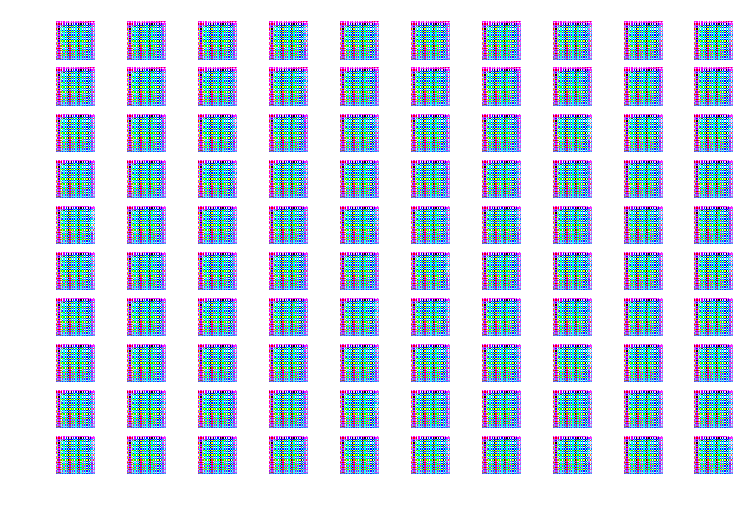

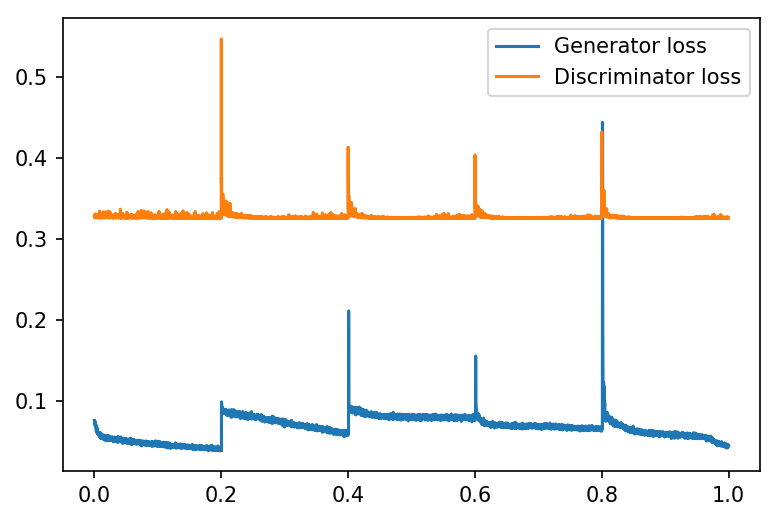

---- Step 5 ----


Training Discriminator *1.00[loss: 0.3261] 100% |#######| Elapsed Time: 0:18:54
Training Generator *0.60[loss: 0.0576] 100% |###########| Elapsed Time: 0:07:48


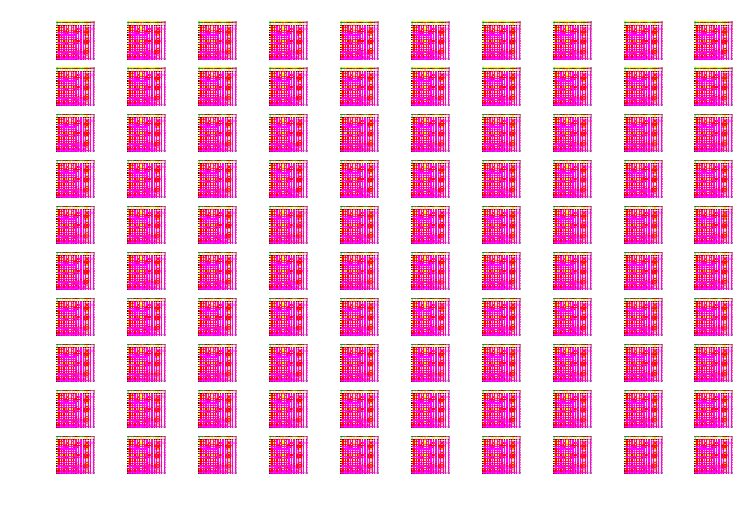

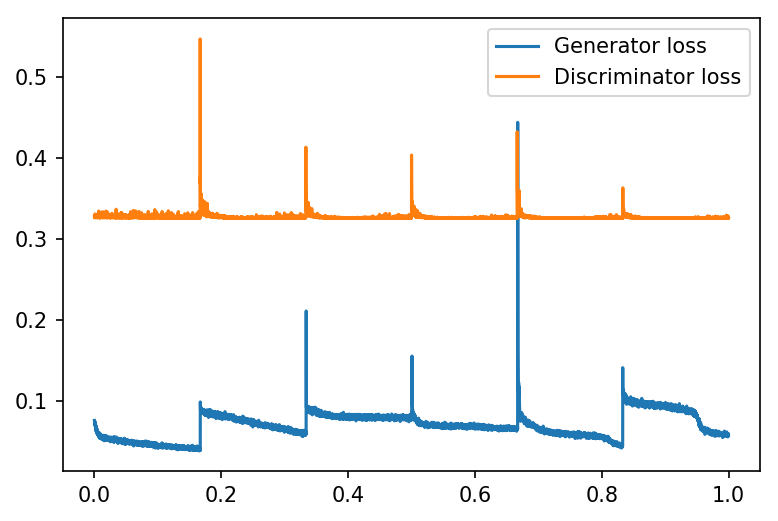

---- Step 6 ----


Training Discriminator *1.00[loss: 0.3260] 100% |#######| Elapsed Time: 0:18:54
Training Generator *0.60[loss: 0.0875] 100% |###########| Elapsed Time: 0:07:48


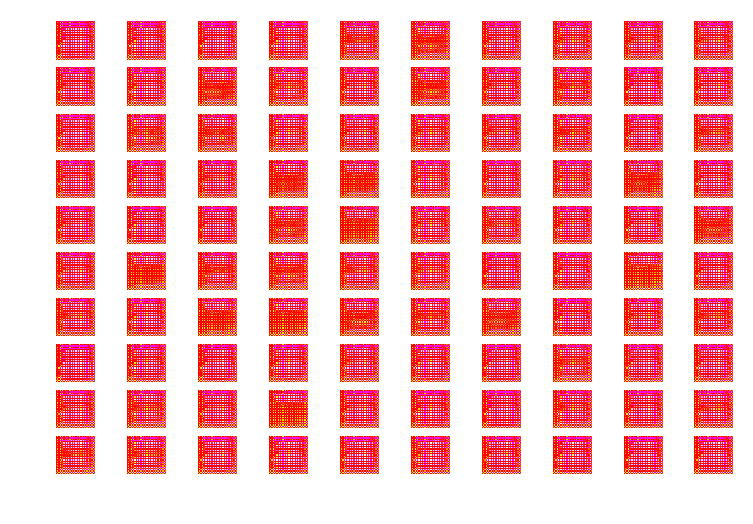

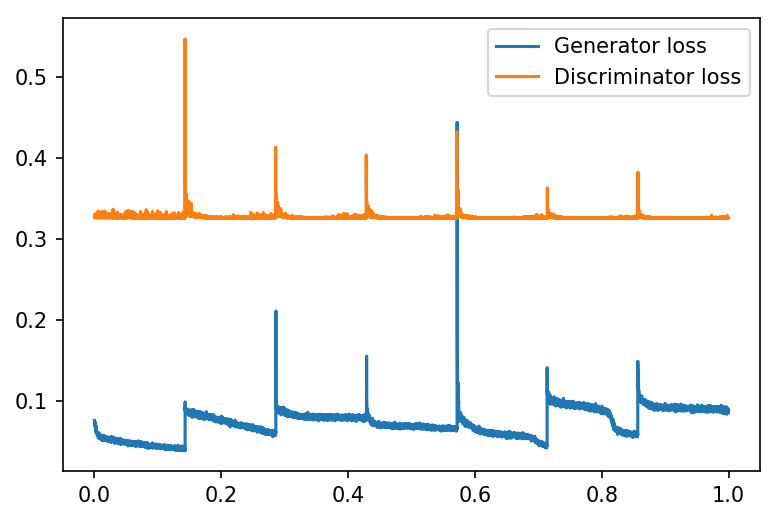

---- Step 7 ----


Training Discriminator *1.00[loss: 0.3258] 100% |#######| Elapsed Time: 0:18:54
Training Generator *0.60[loss: 0.0360] 100% |###########| Elapsed Time: 0:07:48


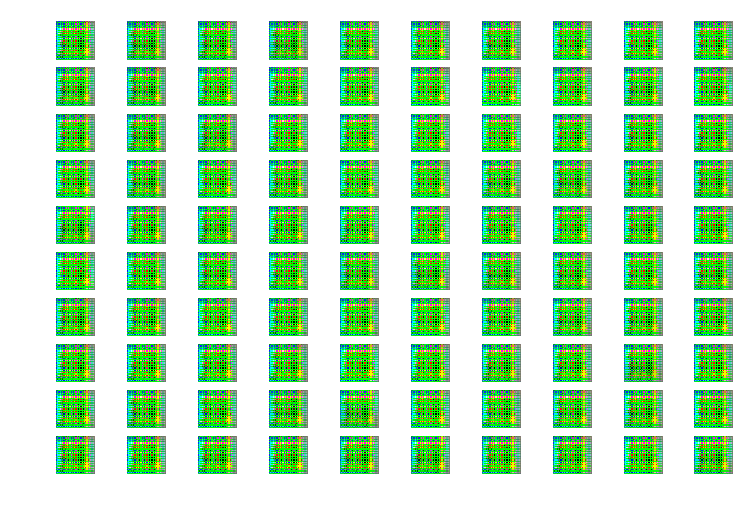

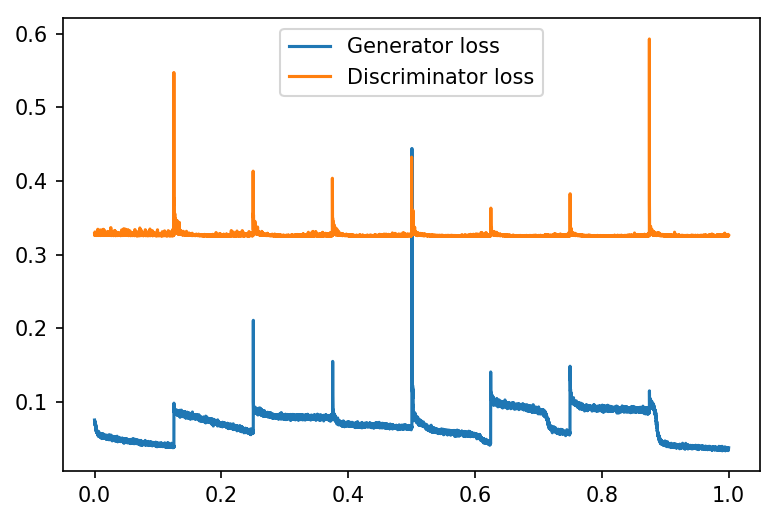

---- Step 8 ----


Training Discriminator *1.00[loss: 0.3257] 100% |#######| Elapsed Time: 0:18:55
Training Generator *0.60[loss: 0.0706] 100% |###########| Elapsed Time: 0:07:49


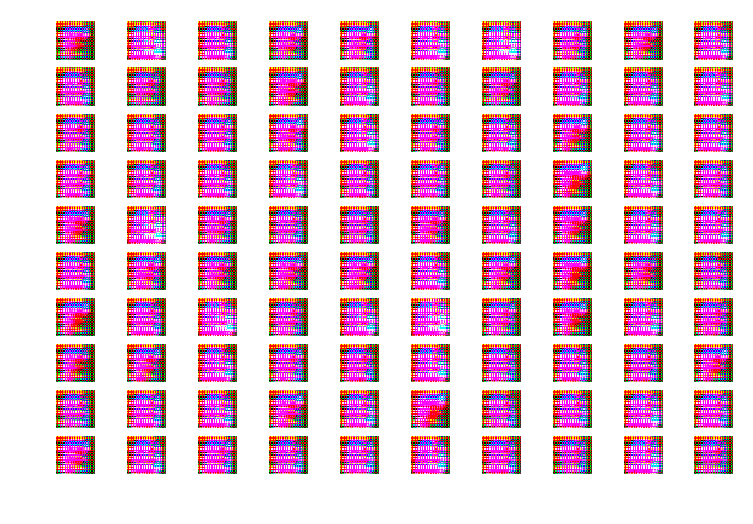

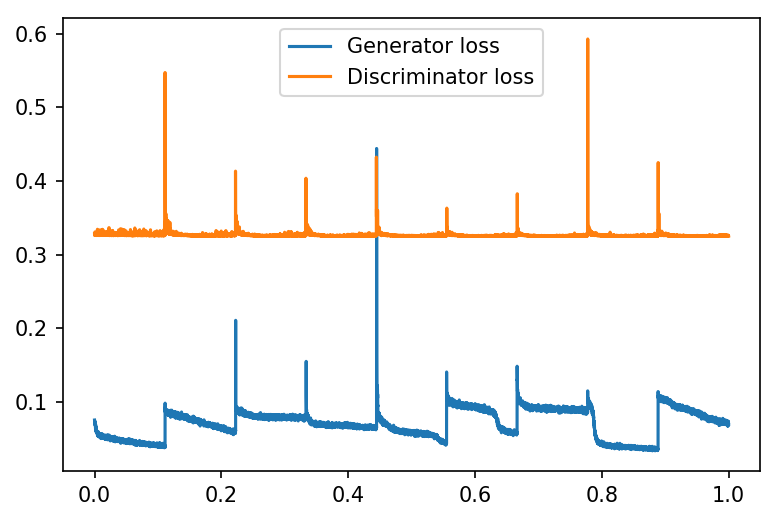

---- Step 9 ----


Training Discriminator *1.00[loss: 0.3259] 100% |#######| Elapsed Time: 0:18:55
Training Generator *0.60[loss: 0.0856] 100% |###########| Elapsed Time: 0:07:48


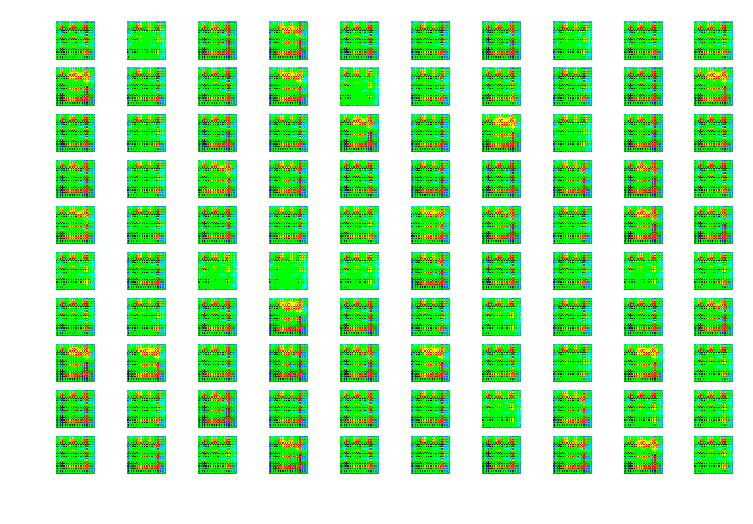

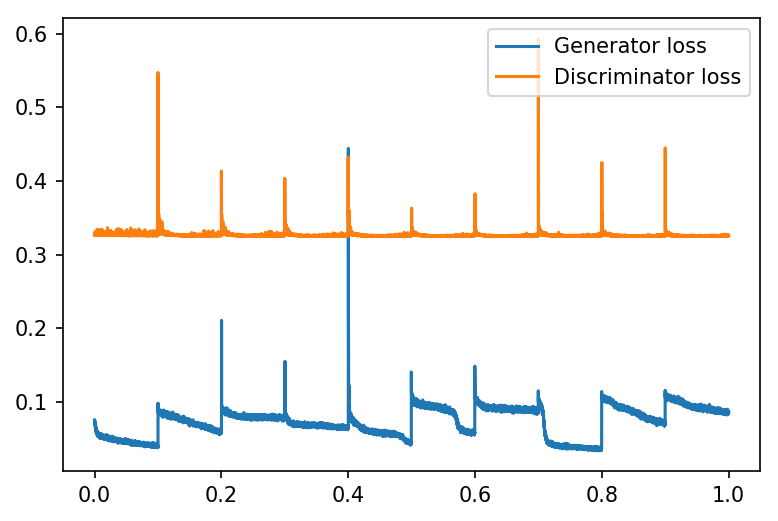

---- Step 10 ----


Training Discriminator *1.00[loss: 0.3257] 100% |#######| Elapsed Time: 0:18:54
Training Generator *0.60[loss: 0.0618] 100% |###########| Elapsed Time: 0:07:50


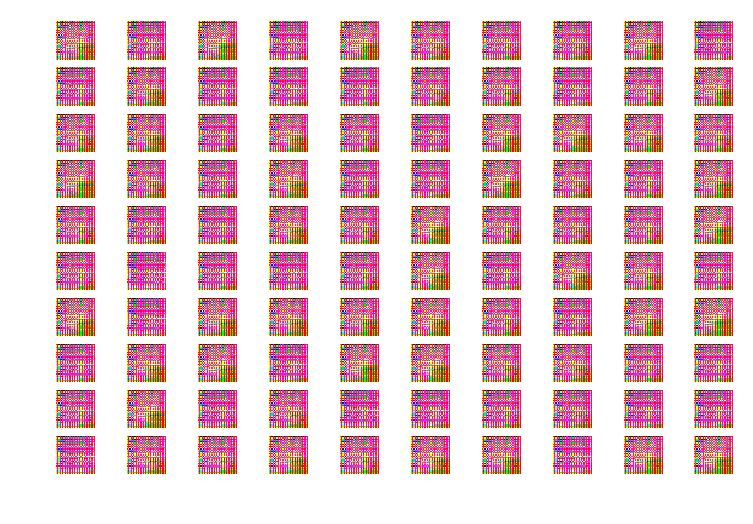

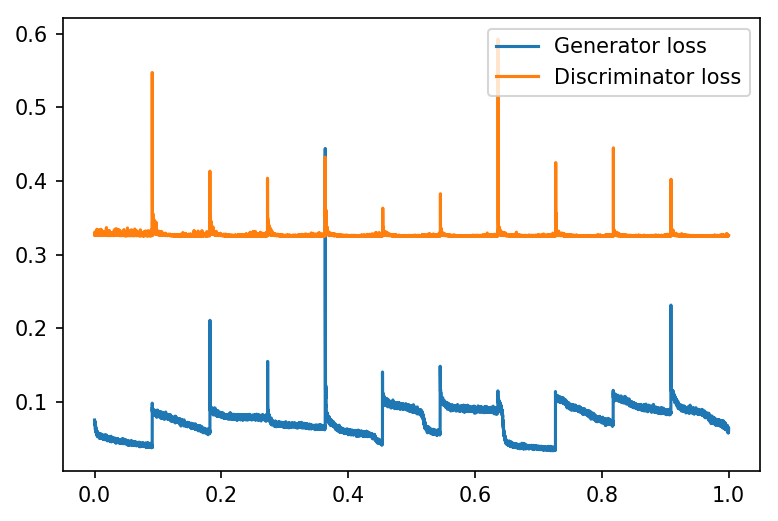

---- Step 11 ----


Training Discriminator *1.00[loss: 0.3256] 100% |#######| Elapsed Time: 0:18:55
Training Generator *0.60[loss: 0.0587] 100% |###########| Elapsed Time: 0:07:48


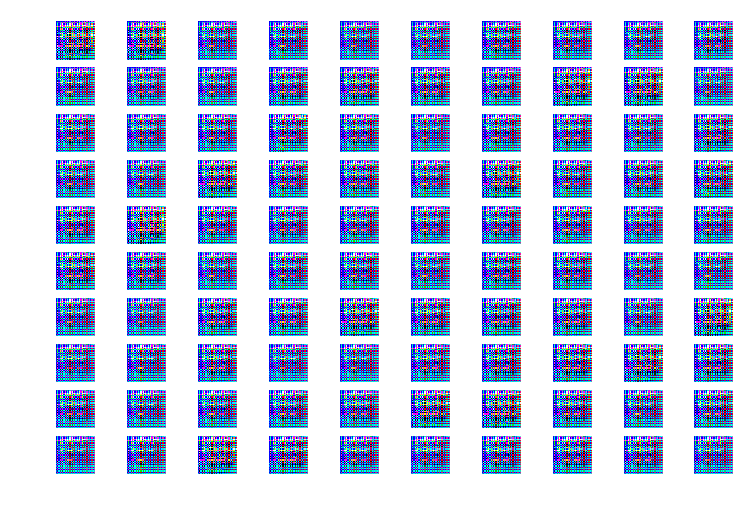

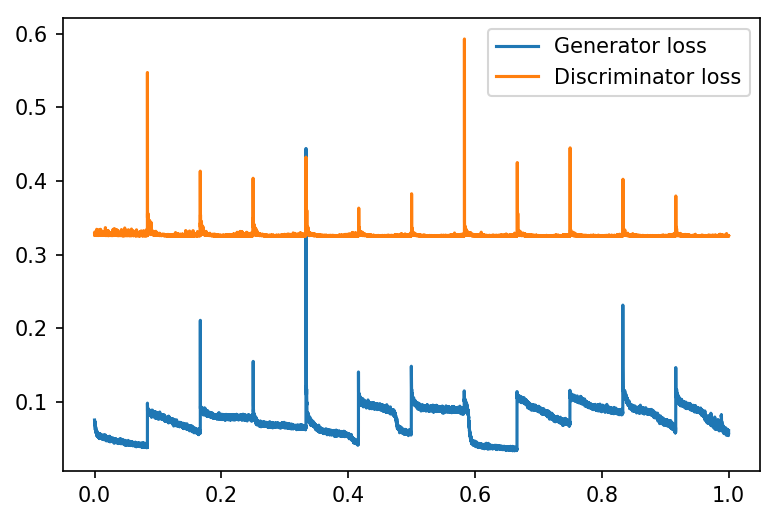

---- Step 12 ----


Training Discriminator *1.00[loss: 0.3256] 100% |#######| Elapsed Time: 0:18:54
Training Generator *0.60[loss: 0.0867] 100% |###########| Elapsed Time: 0:07:48


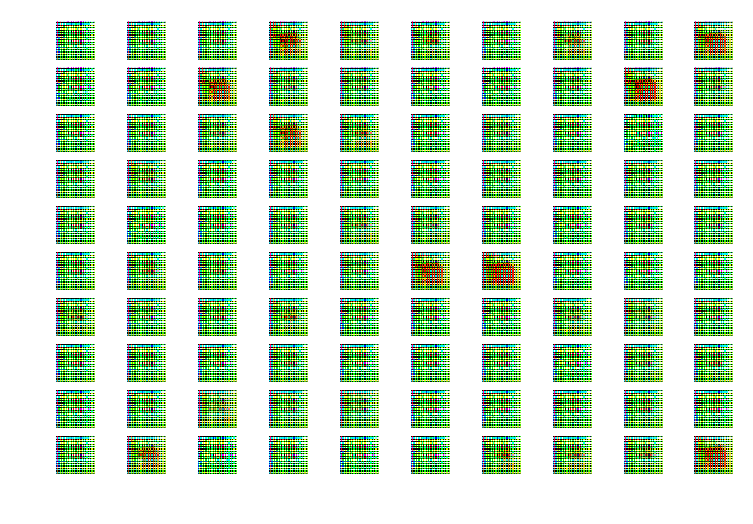

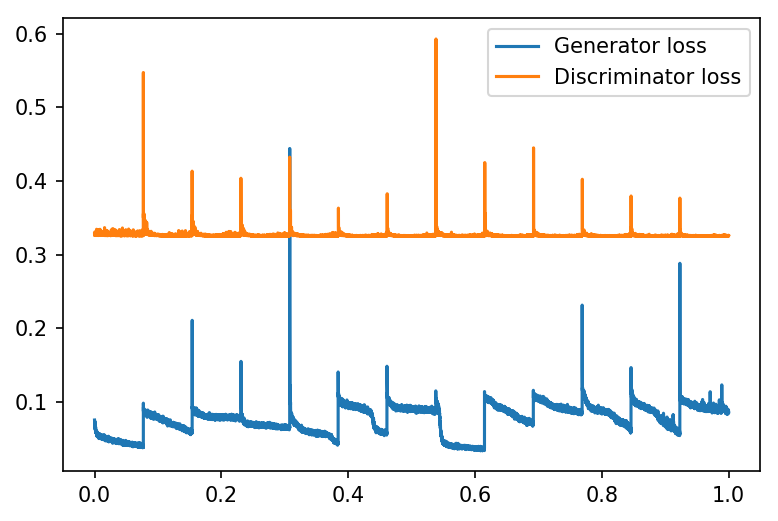

---- Step 13 ----


Training Discriminator *1.00[loss: 0.3257] 100% |#######| Elapsed Time: 0:18:55
Training Generator *0.60[loss: 0.0716] 100% |###########| Elapsed Time: 0:07:48


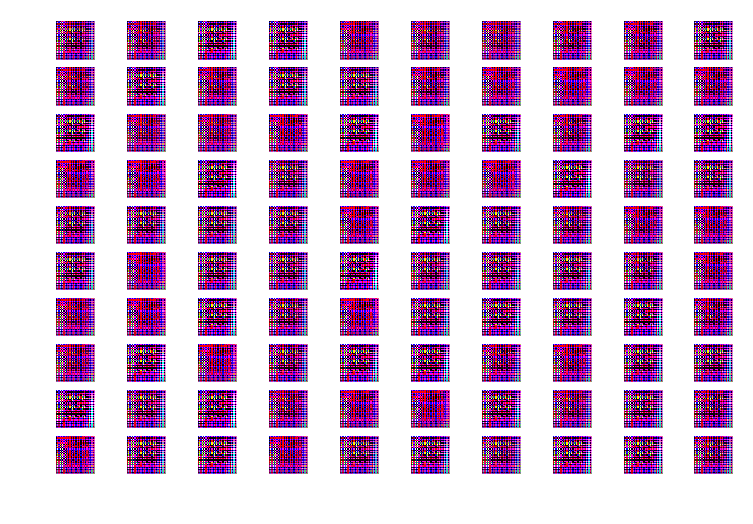

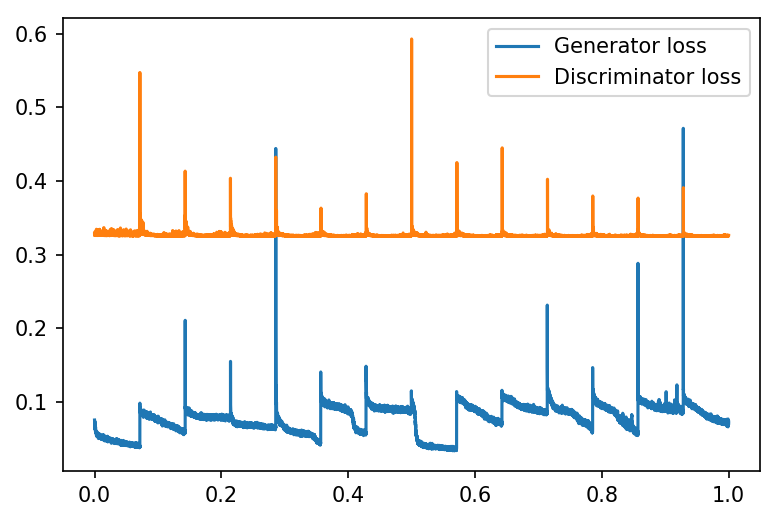

---- Step 14 ----


Training Discriminator *1.00[loss: 0.3256] 100% |#######| Elapsed Time: 0:18:55
Training Generator *0.60[loss: 0.1054] 100% |###########| Elapsed Time: 0:07:48


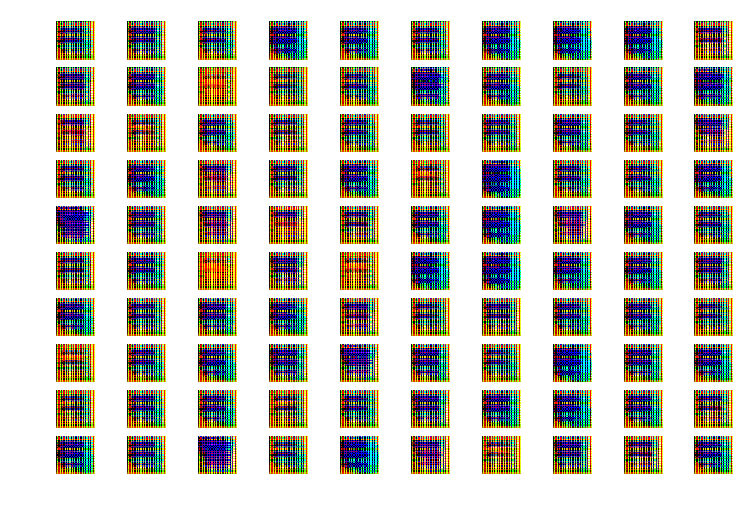

Training Generator *0.60[loss: 0.1008] 100% |###########| Elapsed Time: 0:07:49


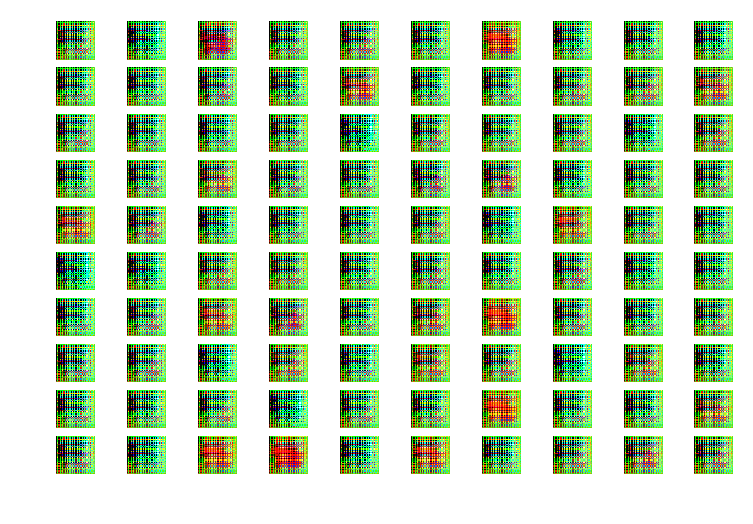

Training Generator *0.60[loss: 0.0970] 100% |###########| Elapsed Time: 0:07:49


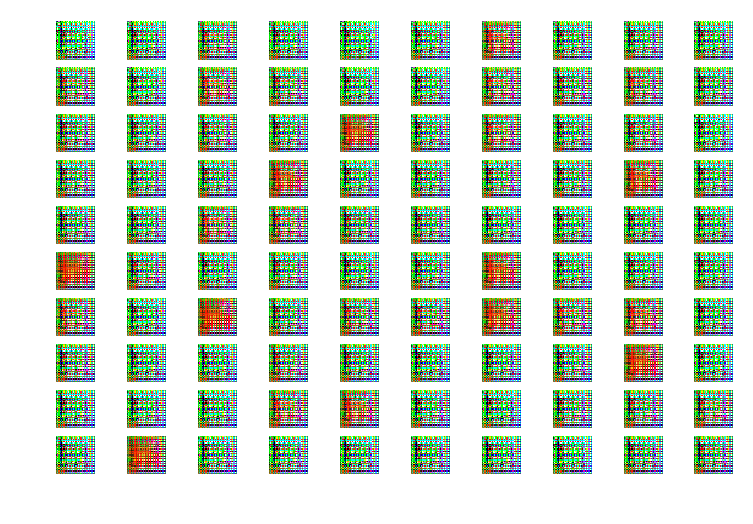

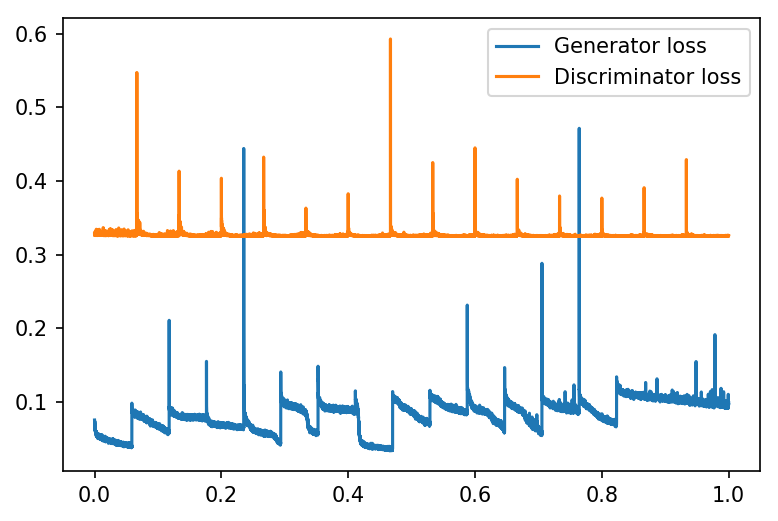

---- Step 15 ----


Training Discriminator *1.00[loss: 0.3255] 100% |#######| Elapsed Time: 0:18:56
Training Generator *0.60[loss: 0.0448] 100% |###########| Elapsed Time: 0:07:49


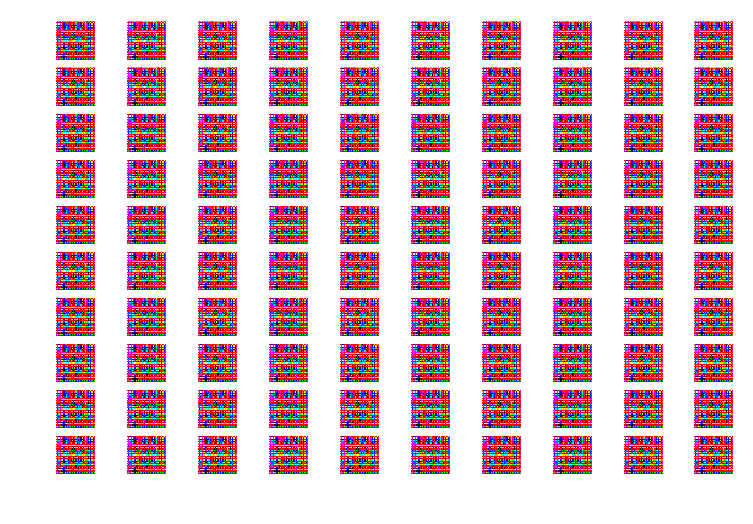

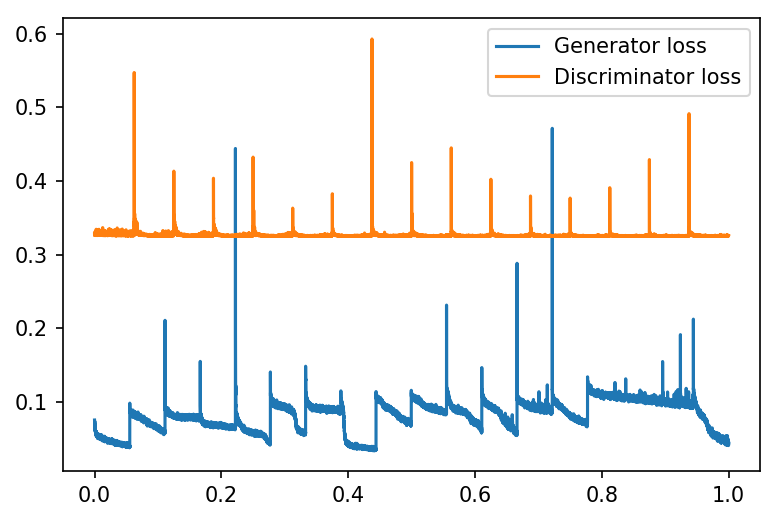

---- Step 16 ----


Training Discriminator *1.00[loss: 0.3256] 100% |#######| Elapsed Time: 0:18:55
Training Generator *0.60[loss: 0.0890] 100% |###########| Elapsed Time: 0:07:48


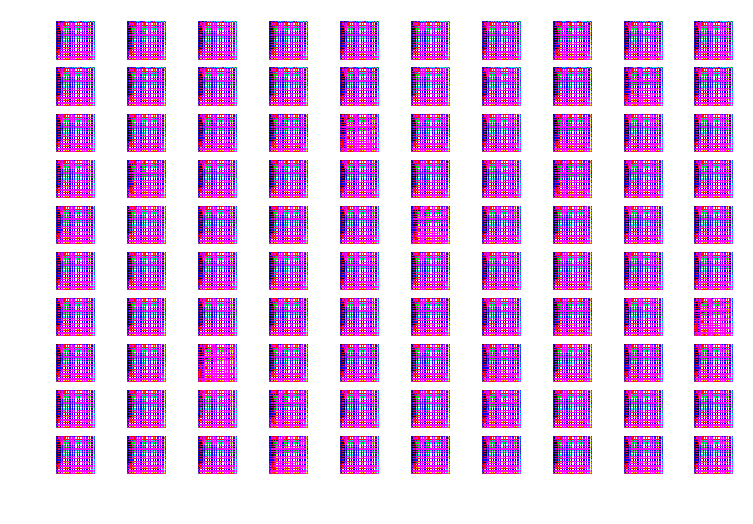

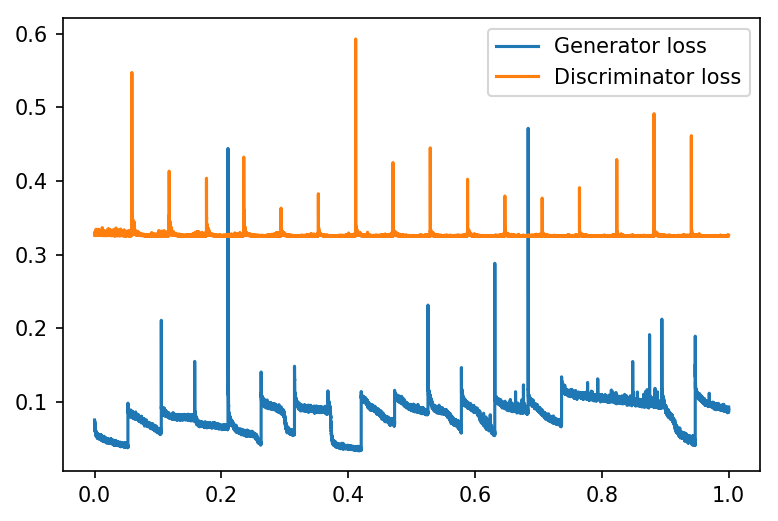

---- Step 17 ----


Training Discriminator *1.00[loss: 0.3255] 100% |#######| Elapsed Time: 0:18:55
Training Generator *0.60[loss: 0.0870] 100% |###########| Elapsed Time: 0:07:49


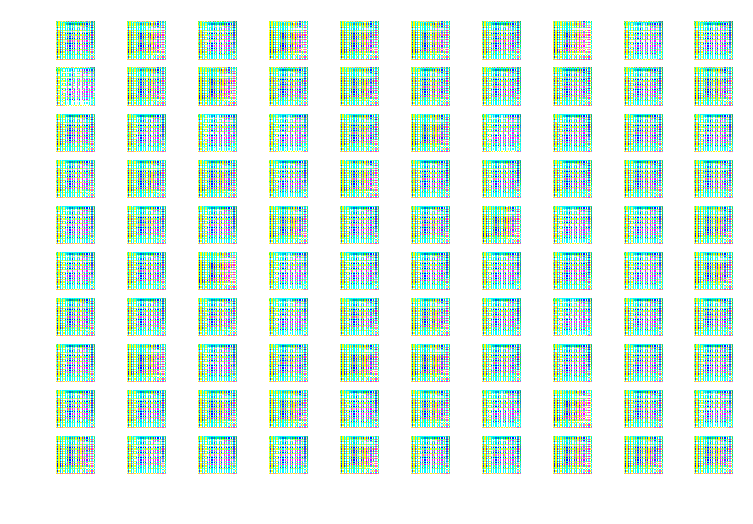

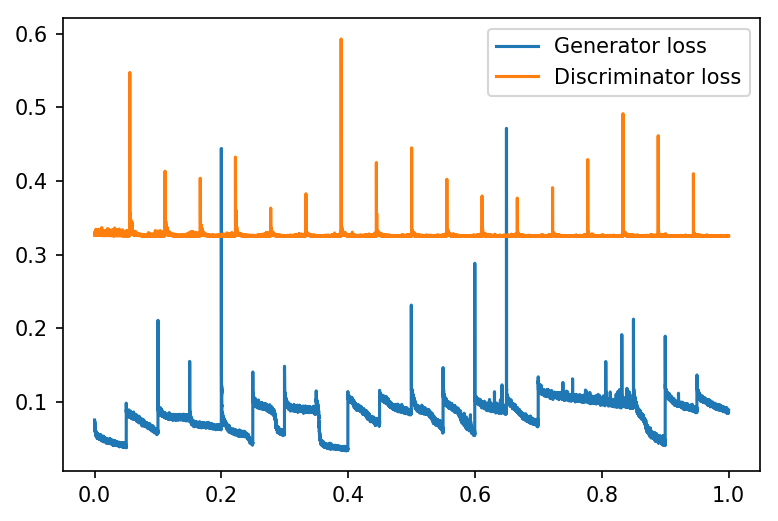

---- Step 18 ----


Training Discriminator *1.00[loss: 0.3254] 100% |#######| Elapsed Time: 0:18:56
Training Generator *0.60[loss: 0.0796] 100% |###########| Elapsed Time: 0:07:49


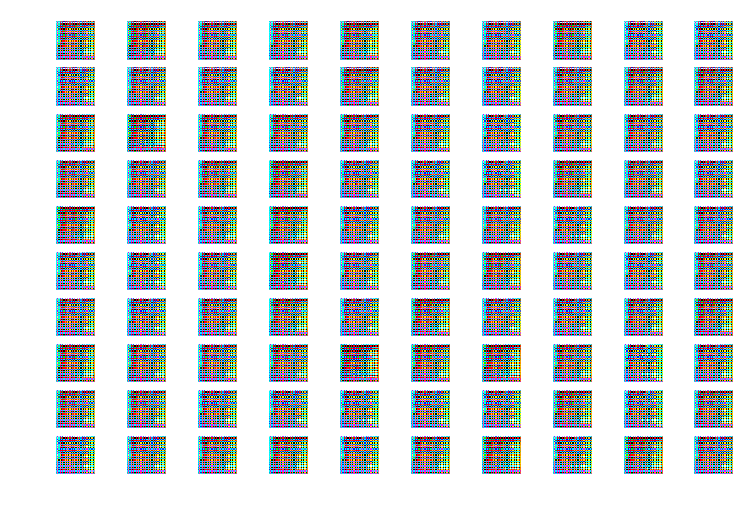

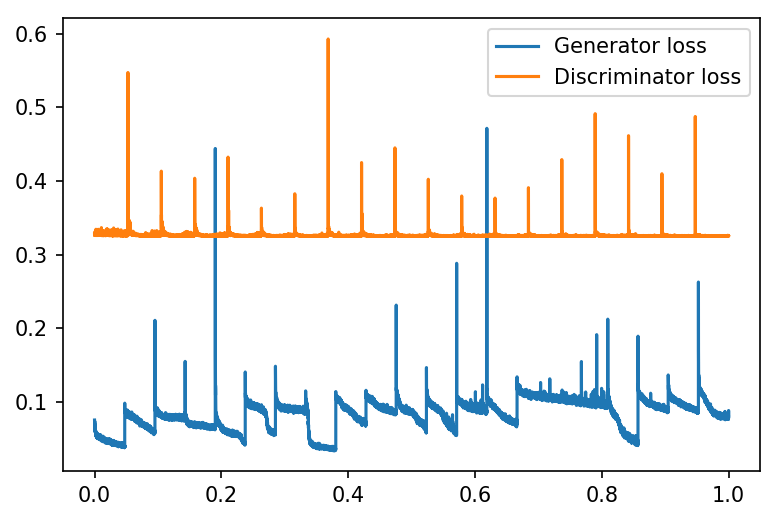

---- Step 19 ----


Training Discriminator *1.00[loss: 0.3255] 100% |#######| Elapsed Time: 0:18:56
Training Generator *0.60[loss: 0.0985] 100% |###########| Elapsed Time: 0:07:49


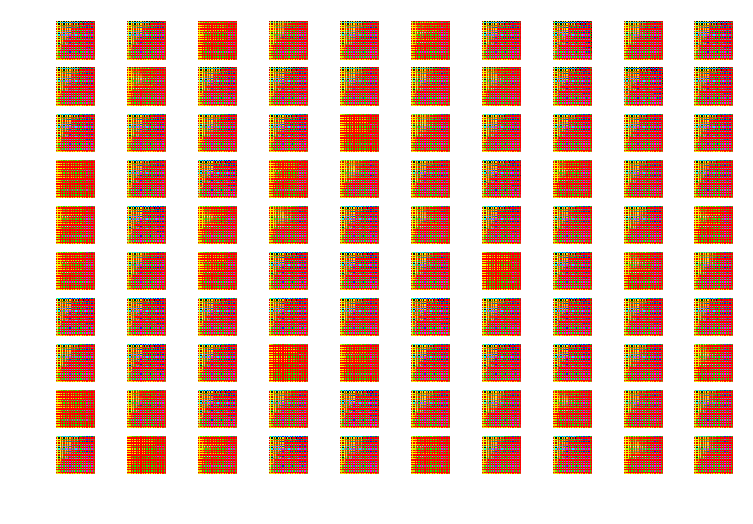

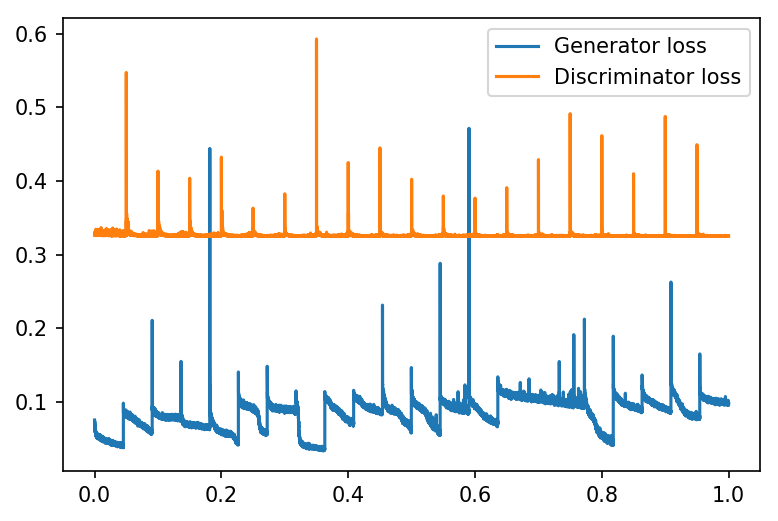

---- Step 20 ----


Training Discriminator *1.00[loss: 0.3254] 100% |#######| Elapsed Time: 0:18:55
Training Generator *0.60[loss: 0.0896] 100% |###########| Elapsed Time: 0:07:48


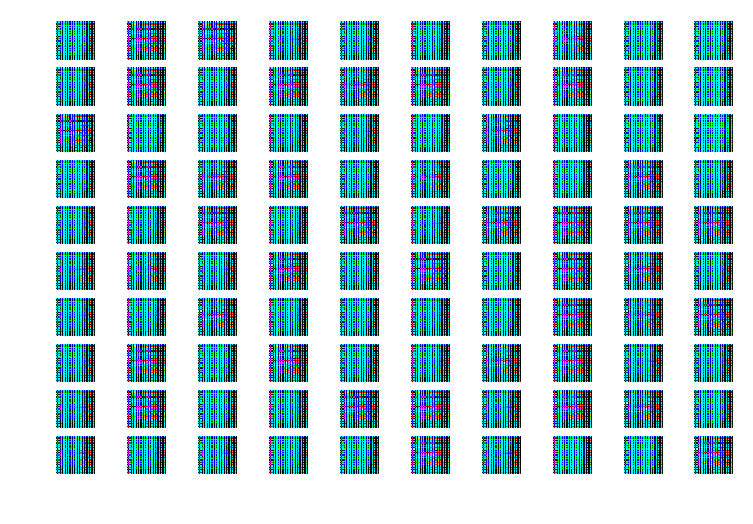

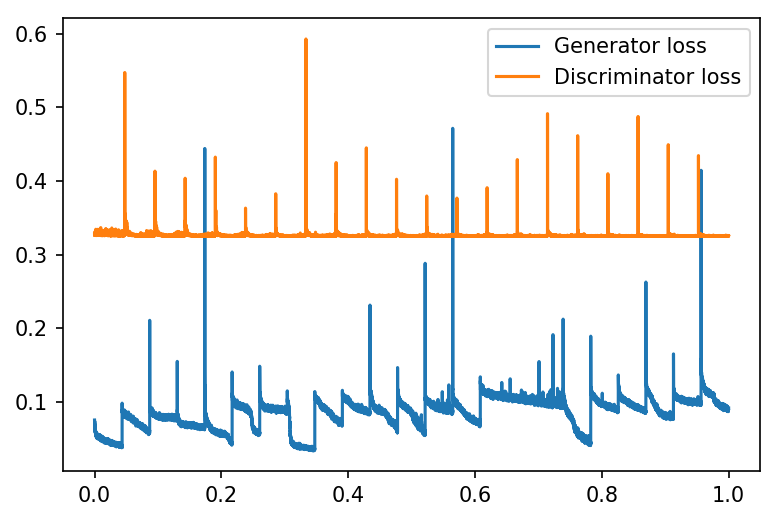

---- Step 21 ----


Training Discriminator *1.00[loss: 0.3255] 100% |#######| Elapsed Time: 0:18:55
Training Generator *0.60[loss: 0.0785] 100% |###########| Elapsed Time: 0:07:48


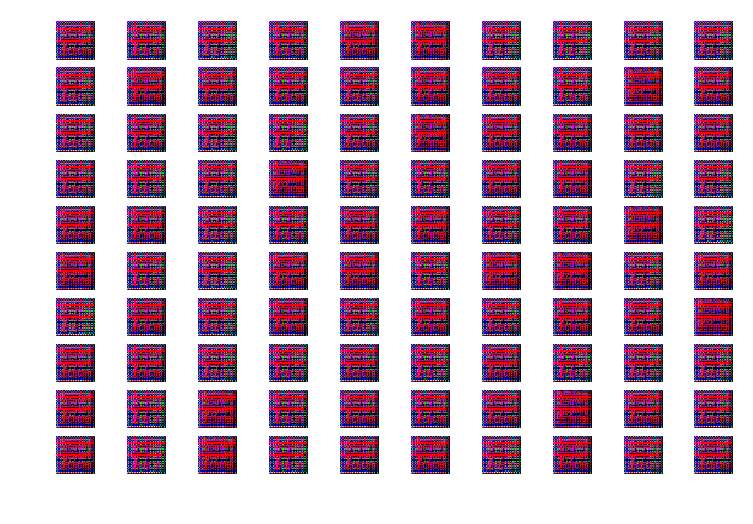

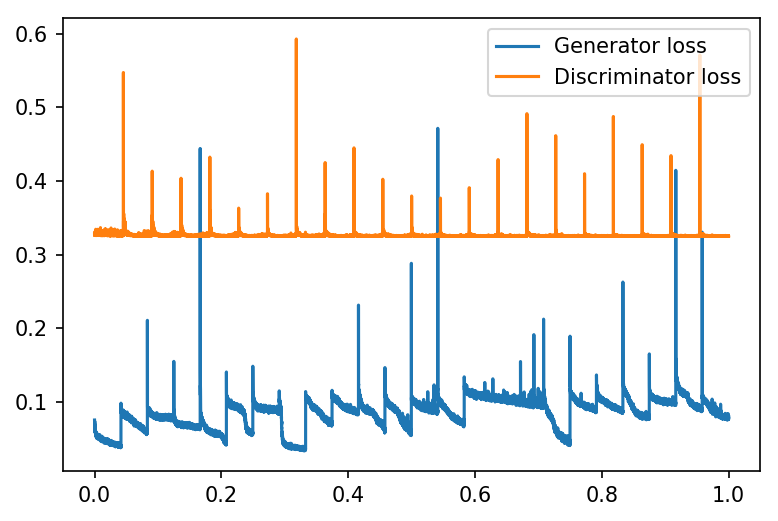

---- Step 22 ----


Training Discriminator *1.00[loss: 0.3254] 100% |#######| Elapsed Time: 0:18:56
Training Generator *0.60[loss: 0.0996] 100% |###########| Elapsed Time: 0:07:48


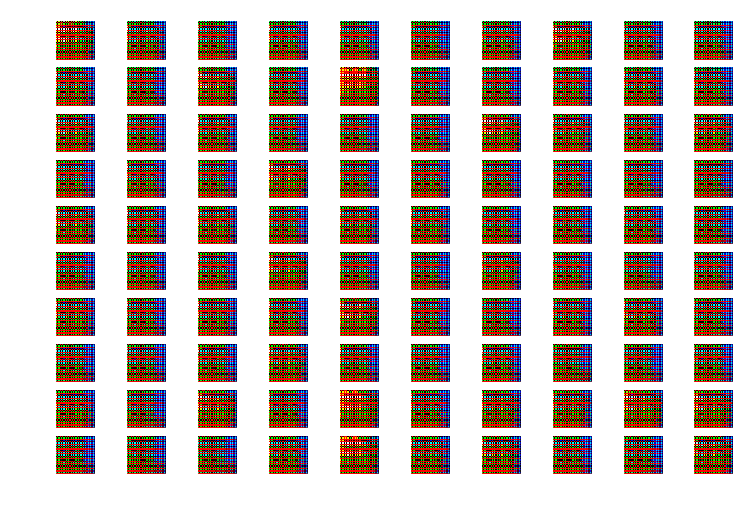

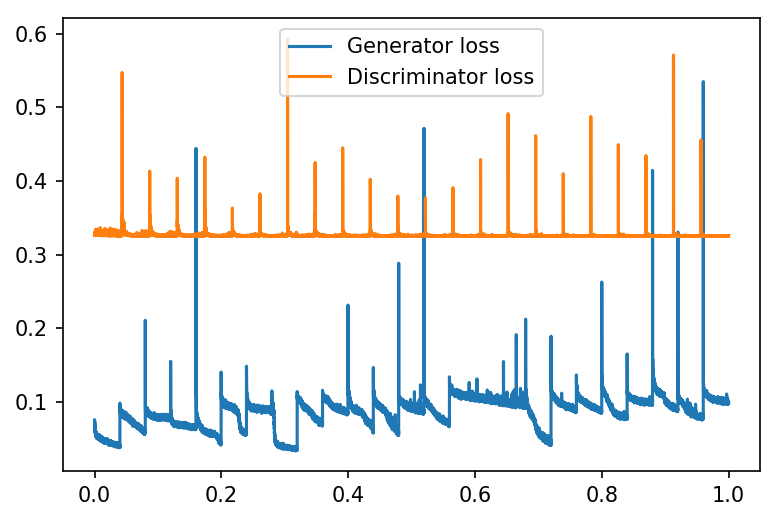

---- Step 23 ----


Training Discriminator *1.00[loss: 0.3255] 100% |#######| Elapsed Time: 0:18:55
Training Generator *0.60[loss: 0.1022] 100% |###########| Elapsed Time: 0:07:48


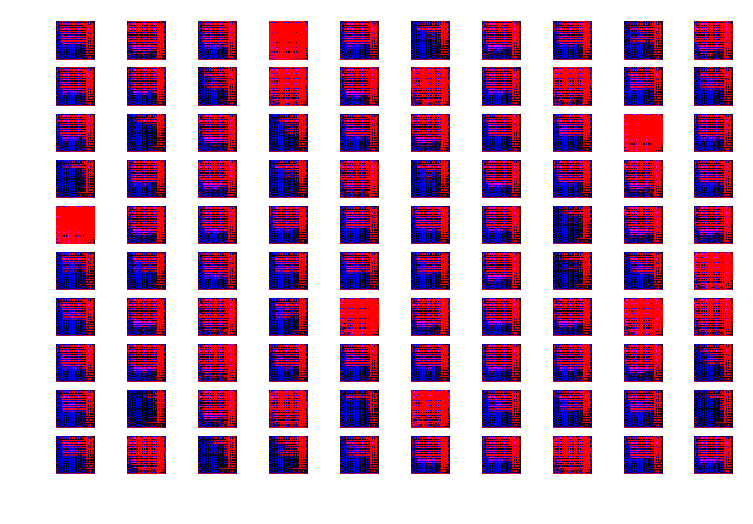

Training Generator *0.60[loss: 0.0999]  17% |#          | Elapsed Time: 0:01:23

KeyboardInterrupt: 

In [22]:
strategy_train(30, 
               min_loss_d=.33,
               min_loss_g=.1,
               max_pass=4)

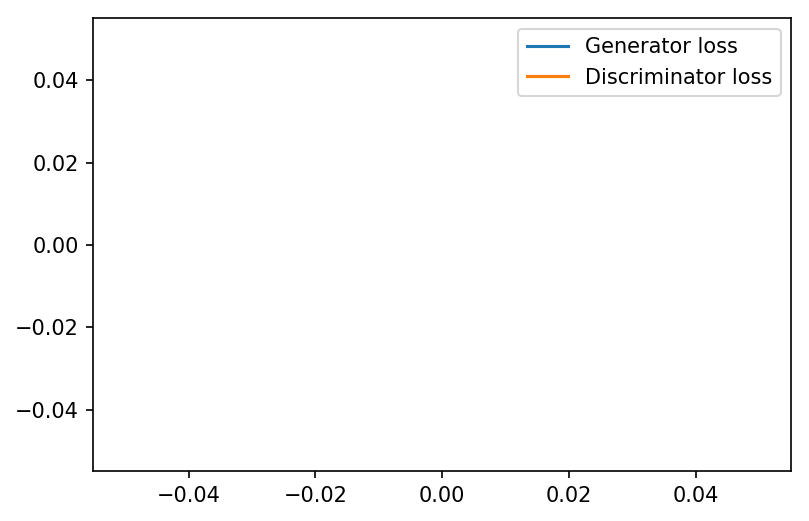

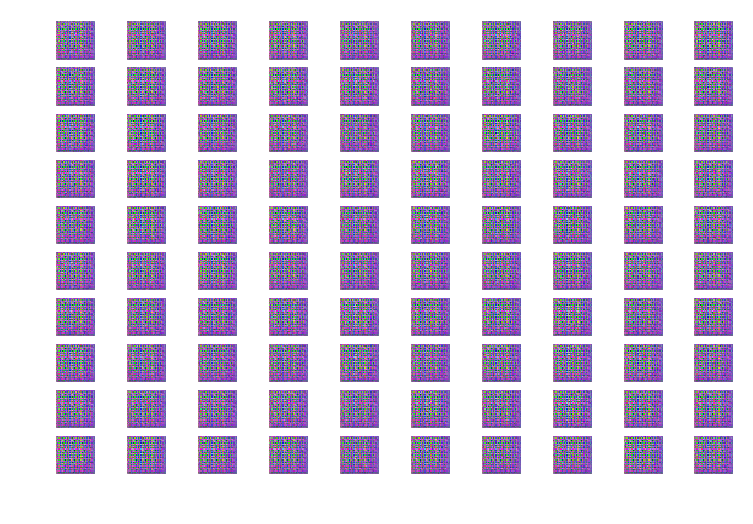

In [48]:
# losses = {'d': [], 'g': []}

display_loss()
display_gen_output()

In [24]:
def save():
    timestamp = str(datetime.datetime.now())
    
    generator.save(timestamp + "_generator.h5")
    discriminator.save(timestamp + "_discriminator.h5")
       

In [ ]:
while True:
    l_d, mean_loss_d = epoch_discriminator(1.0)   
    losses['d'] += l_d

    if mean_loss_d < 0.5:
        break


In [ ]:
discriminator.predict_on_batch(data[0:32])
# discriminator.predict_on_batch(batch_generator()[0])

In [24]:
save()

In [28]:
def epoch_mixed(ratio_d_per_g=1.0, 
                generator_step_size=10,
                show=True):
    
    np.random.shuffle(data)
    global mean_loss_g, mean_loss_d
    
    history = {'d': [], 'g': []}
    
    accumulator_g = 0.
    
    bar = mixed_progress_bar()

    for i in bar(range(STEP_PER_EPOCH)):
        set_trainable(discriminator, True)
        bar.set_mode(True)
                
        loss = discriminator.train_on_batch(*batch_generator())
        loss += discriminator.train_on_batch(*batch_dataset(i))

        mean_loss_d = 0.95 * mean_loss_g + 0.05 * loss
        bar.update_loss(mean_loss_d, discriminator=True)
        history['d'].append(loss)

        accumulator_g += ratio_d_per_g
        
        if accumulator_g > generator_step_size:
            set_trainable(discriminator, False)
            bar.set_mode(False)

            for j in range(generator_step_size):
                loss = discriminator_on_generator.train_on_batch(*batch_noise())
                loss += discriminator_on_generator.train_on_batch(*batch_noise())

                mean_loss_g = 0.95 * mean_loss_g + 0.05 * loss
                bar.update_loss(mean_loss_g, discriminator=False)
                history['g'].append(loss)
                bar.update(i)

            accumulator_g -= generator_step_size
        
        if show:
            display_gen_output()

    return history

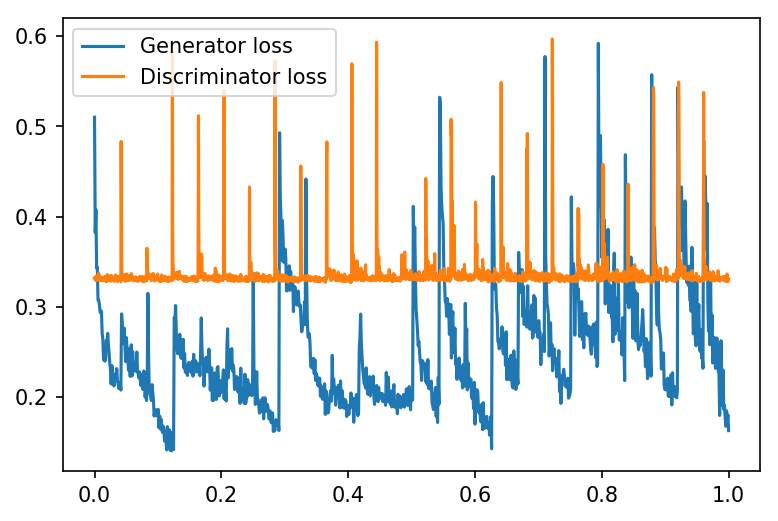

Training G...[loss_d: 0.3971/ loss_g: 0.4746]   1% |    | Elapsed Time: 0:00:38

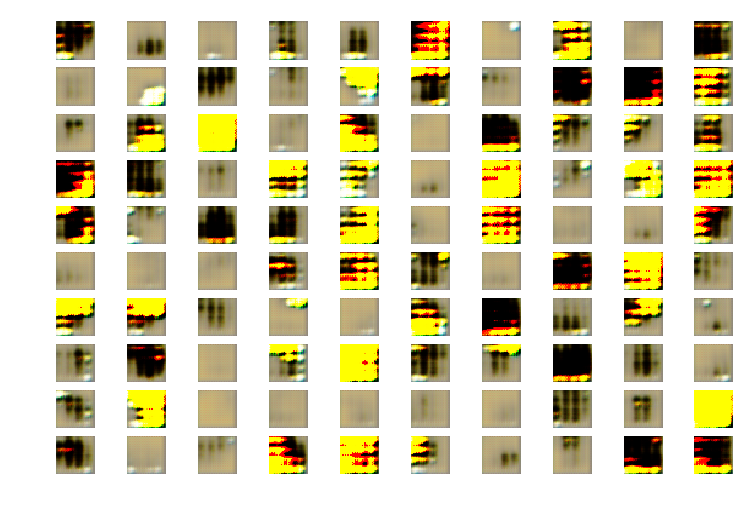

Training G...[loss_d: 0.4677/ loss_g: 0.5022]   3% |    | Elapsed Time: 0:01:25

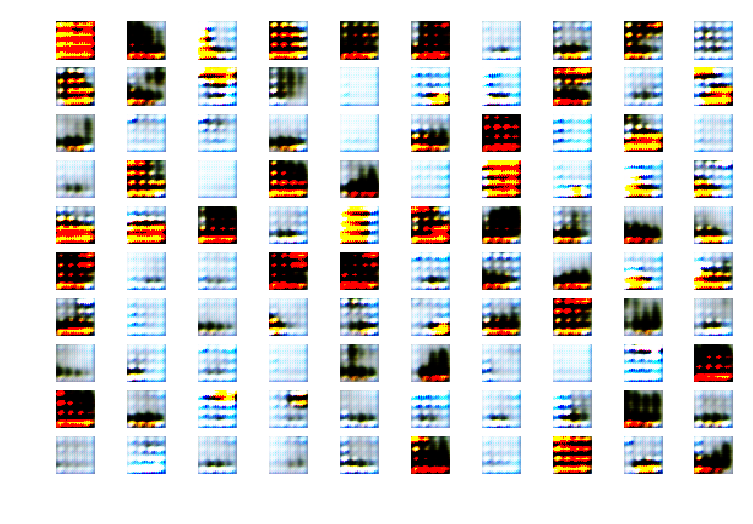

Training G...[loss_d: 0.4938/ loss_g: 0.4909]   5% |    | Elapsed Time: 0:02:13

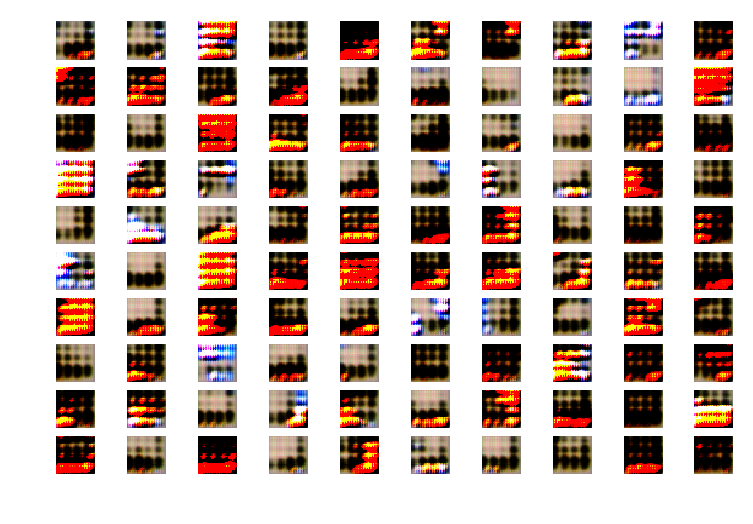

Training G...[loss_d: 0.4828/ loss_g: 0.4651]   6% |    | Elapsed Time: 0:03:00

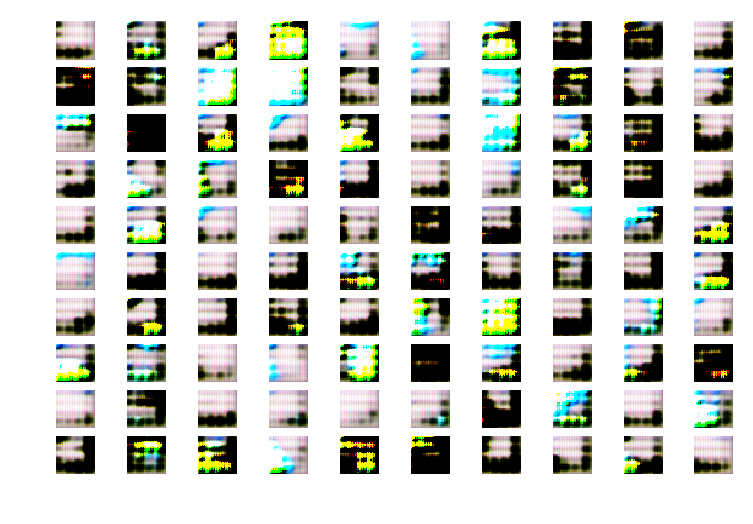

Training G...[loss_d: 0.4584/ loss_g: 0.4817]   8% |    | Elapsed Time: 0:03:48

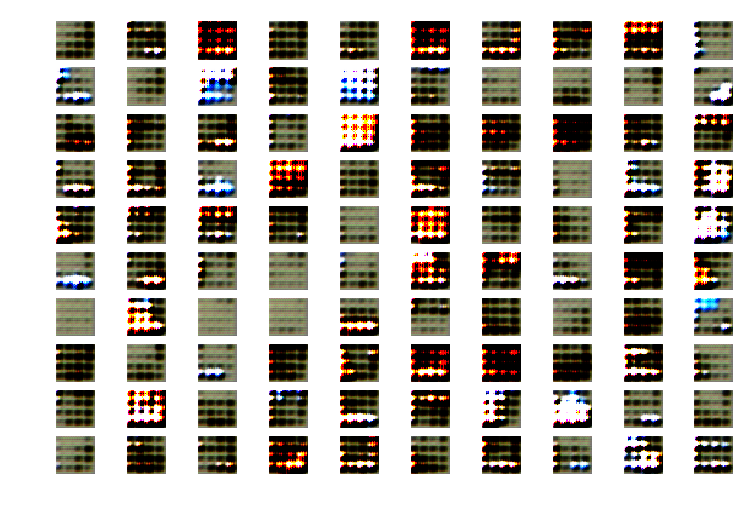

Training G...[loss_d: 0.4740/ loss_g: 0.4988]  10% |    | Elapsed Time: 0:04:35

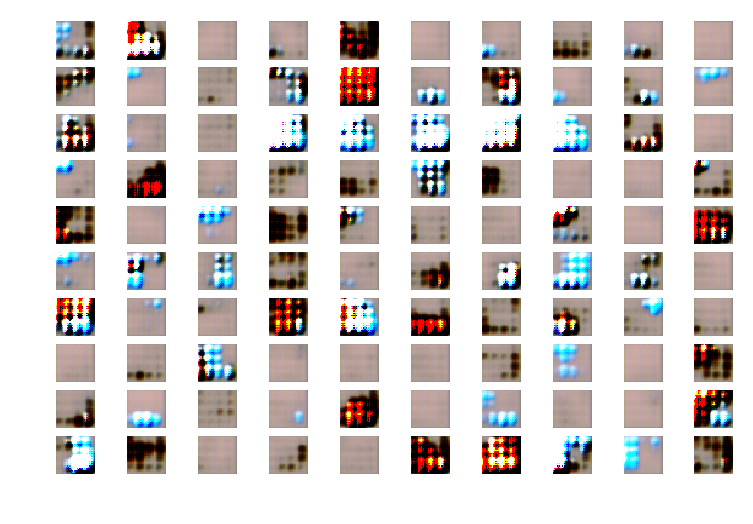

Training G...[loss_d: 0.4905/ loss_g: 0.5467]  12% |    | Elapsed Time: 0:05:22

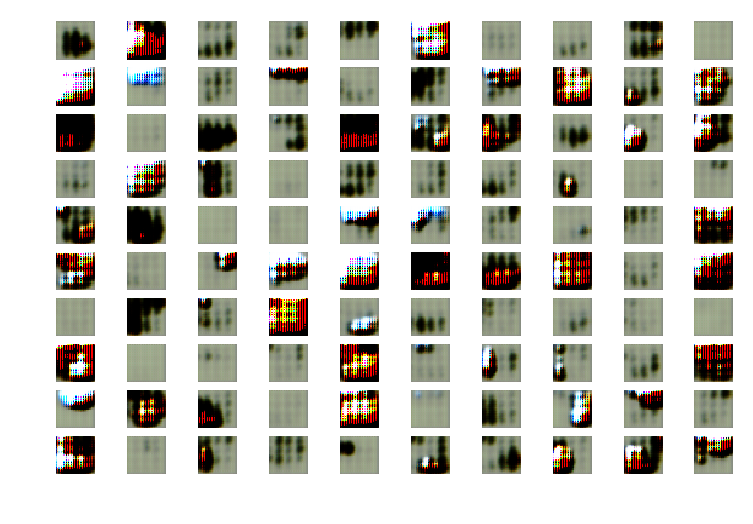

Training G...[loss_d: 0.5361/ loss_g: 0.5172]  13% |    | Elapsed Time: 0:06:09

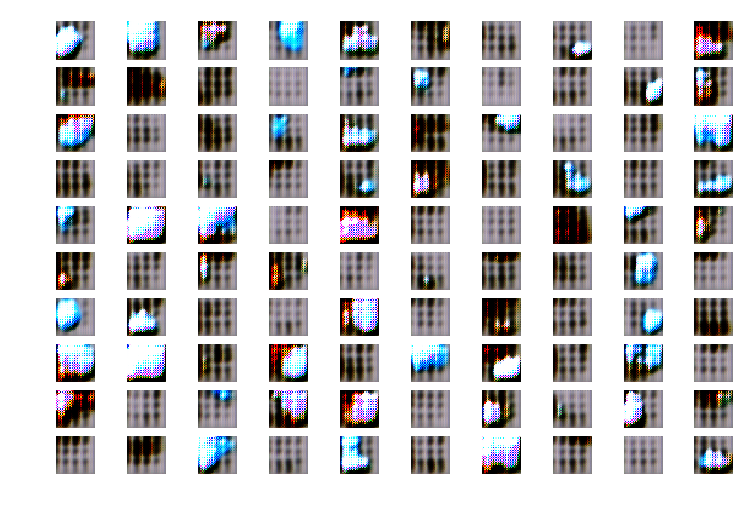

Training G...[loss_d: 0.5081/ loss_g: 0.4890]  15% |    | Elapsed Time: 0:06:56

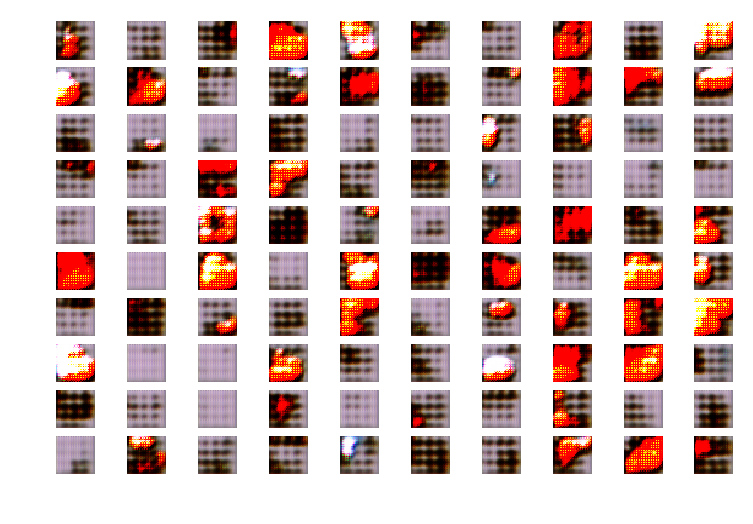

Training G...[loss_d: 0.4811/ loss_g: 0.4131]  17% |    | Elapsed Time: 0:07:44

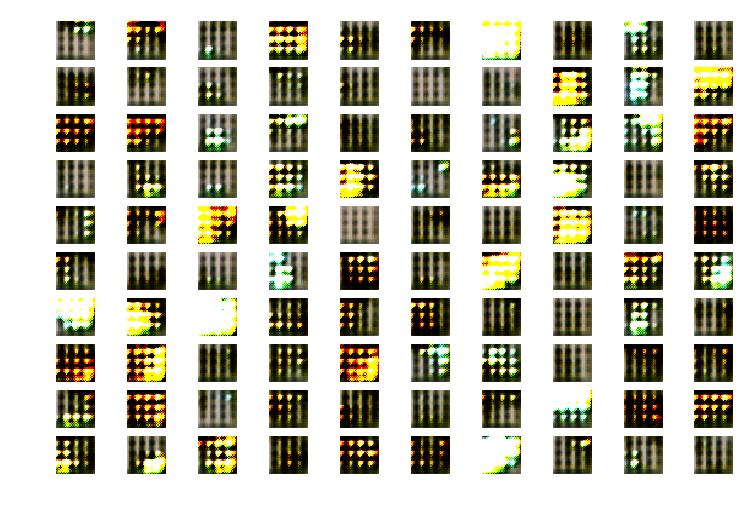

Training G...[loss_d: 0.4089/ loss_g: 0.4138]  18% |    | Elapsed Time: 0:08:31

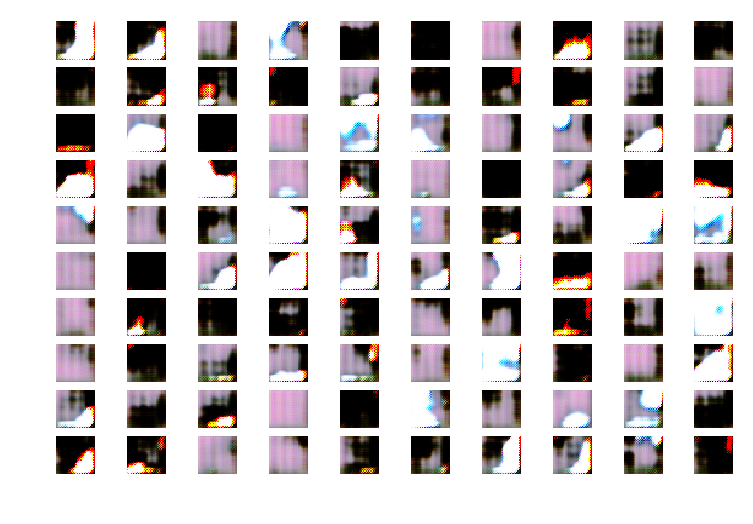

Training G...[loss_d: 0.4098/ loss_g: 0.3978]  20% |    | Elapsed Time: 0:09:18

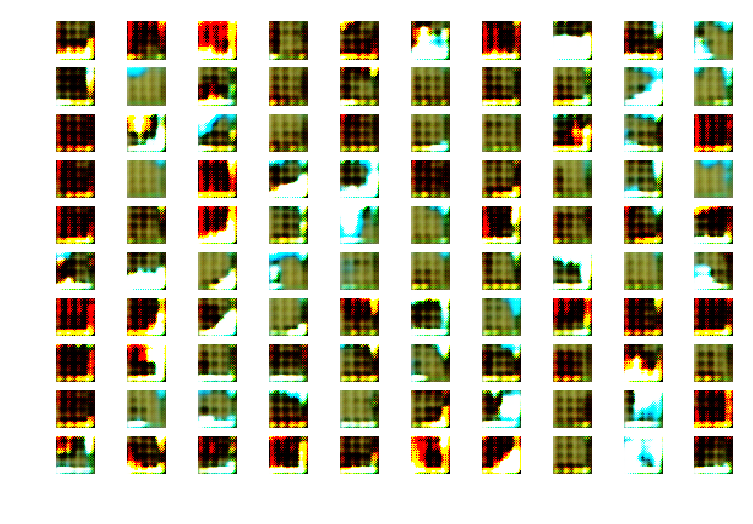

Training G...[loss_d: 0.3948/ loss_g: 0.3661]  22% |    | Elapsed Time: 0:10:05

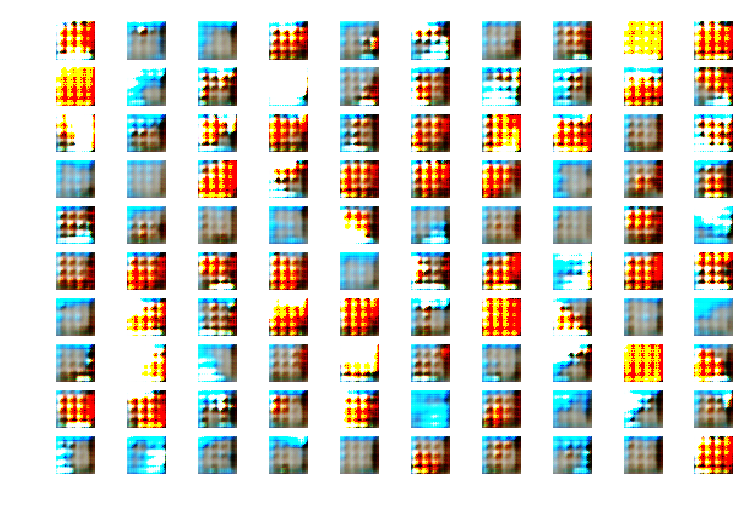

Training G...[loss_d: 0.3647/ loss_g: 0.4763]  24% |    | Elapsed Time: 0:10:53

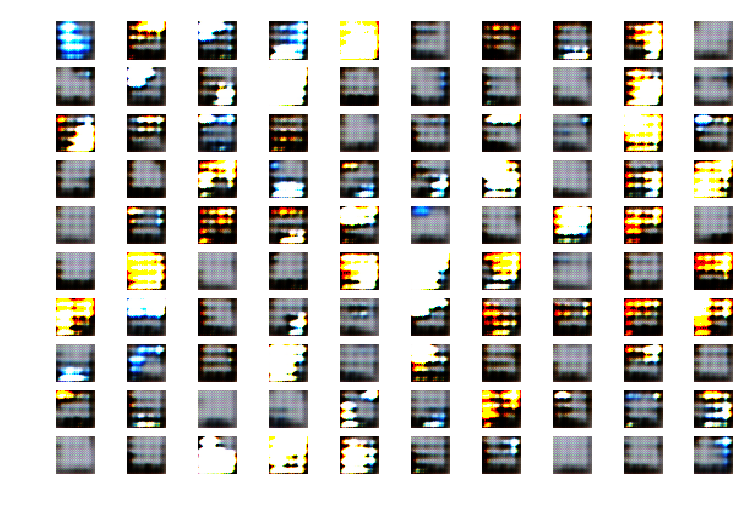

Training G...[loss_d: 0.4701/ loss_g: 0.4452]  25% |#   | Elapsed Time: 0:11:39

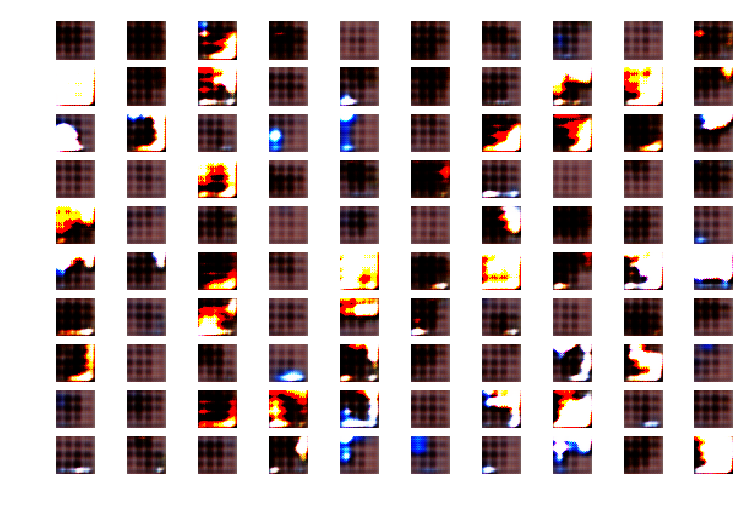

Training G...[loss_d: 0.4395/ loss_g: 0.5015]  27% |#   | Elapsed Time: 0:12:26

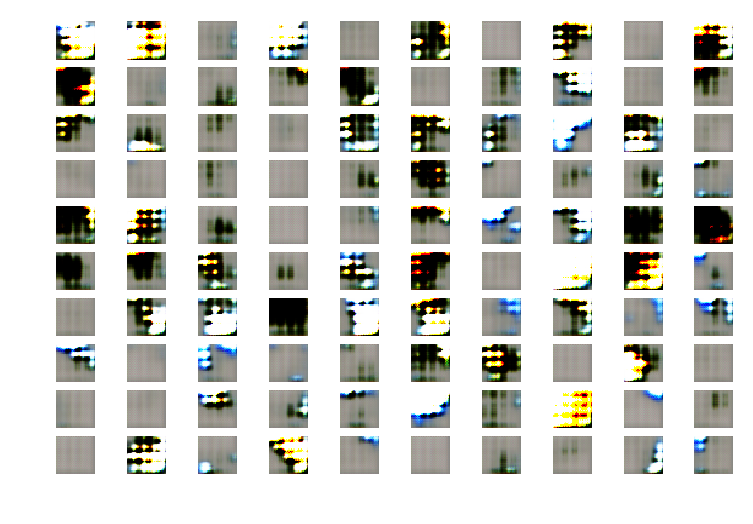

Training G...[loss_d: 0.4933/ loss_g: 0.4935]  29% |#   | Elapsed Time: 0:13:14

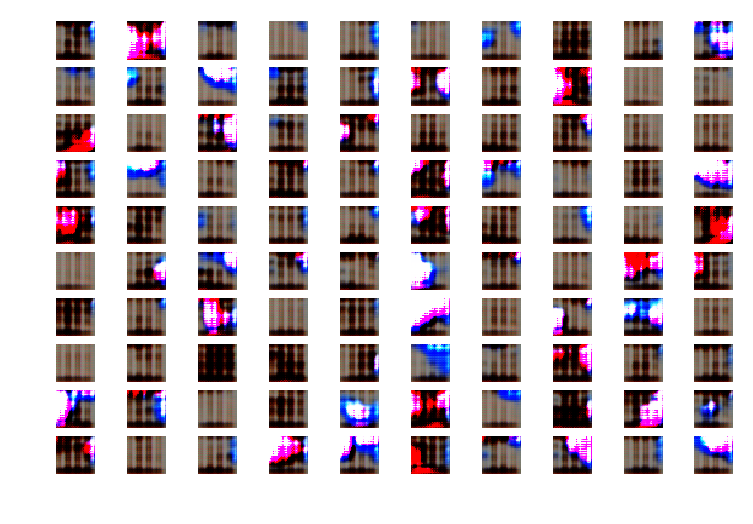

Training G...[loss_d: 0.4854/ loss_g: 0.5772]  30% |#   | Elapsed Time: 0:14:02

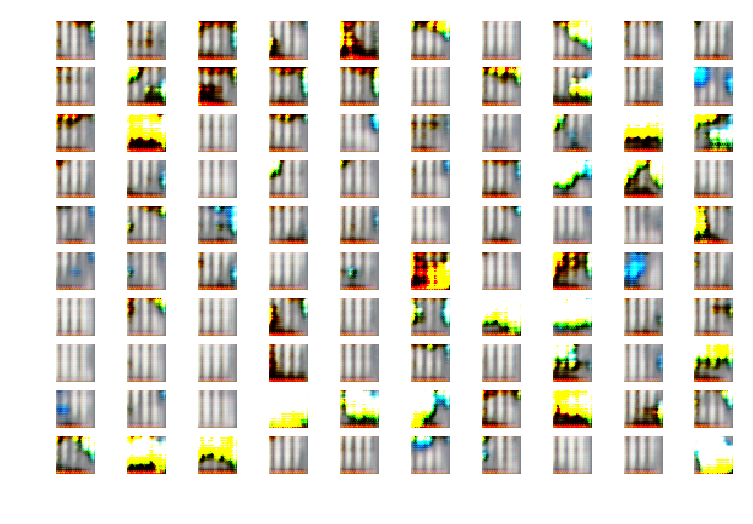

Training G...[loss_d: 0.5650/ loss_g: 0.5772]  32% |#   | Elapsed Time: 0:14:50

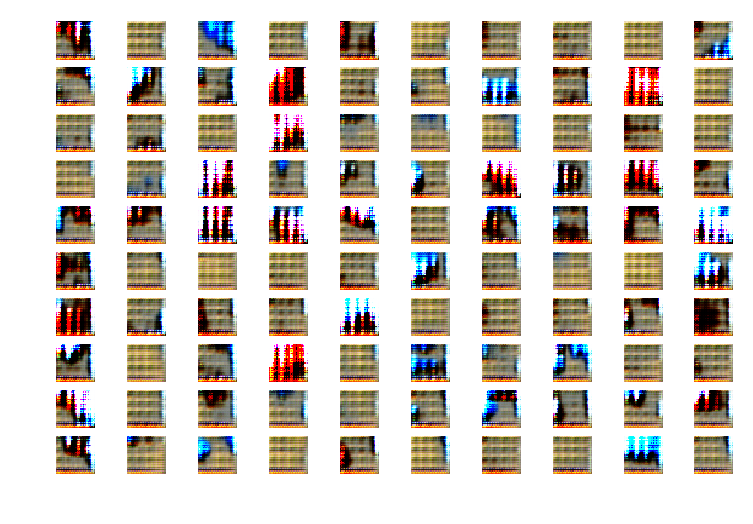

Training G...[loss_d: 0.5650/ loss_g: 0.3803]  34% |#   | Elapsed Time: 0:15:37

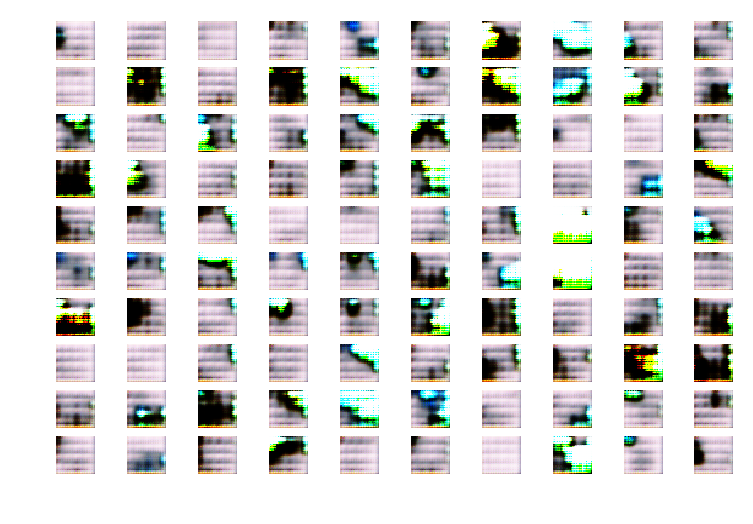

Training G...[loss_d: 0.3779/ loss_g: 0.4926]  36% |#   | Elapsed Time: 0:16:25

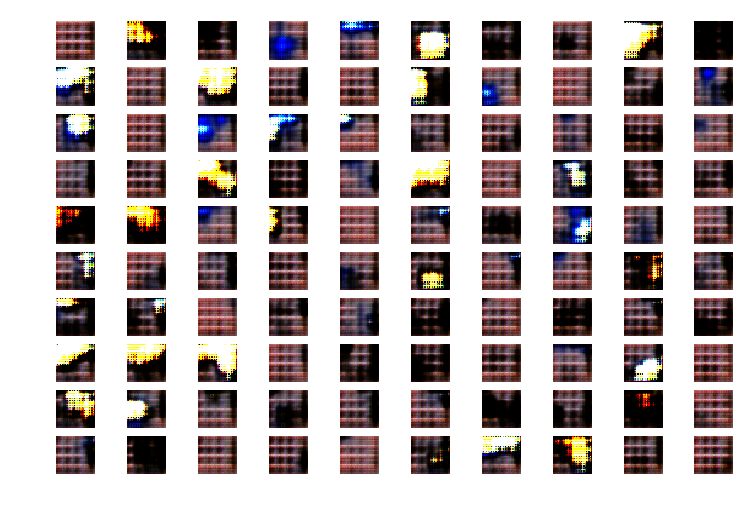

Training G...[loss_d: 0.4846/ loss_g: 0.4536]  37% |#   | Elapsed Time: 0:17:11

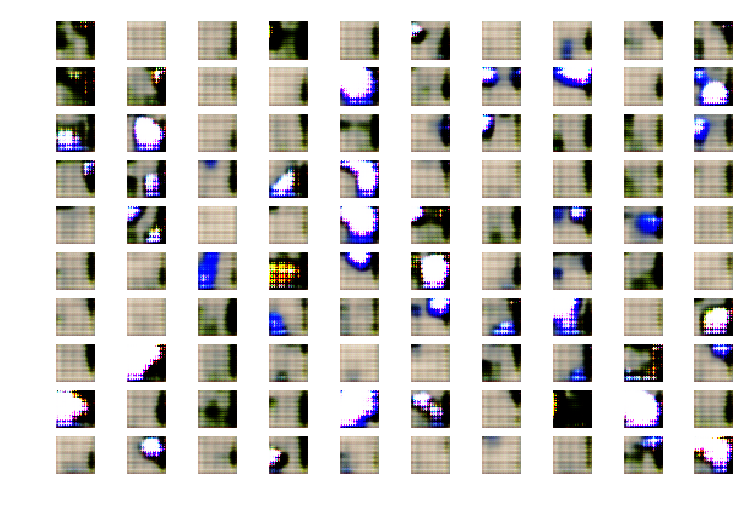

Training G...[loss_d: 0.4477/ loss_g: 0.4555]  39% |#   | Elapsed Time: 0:17:58

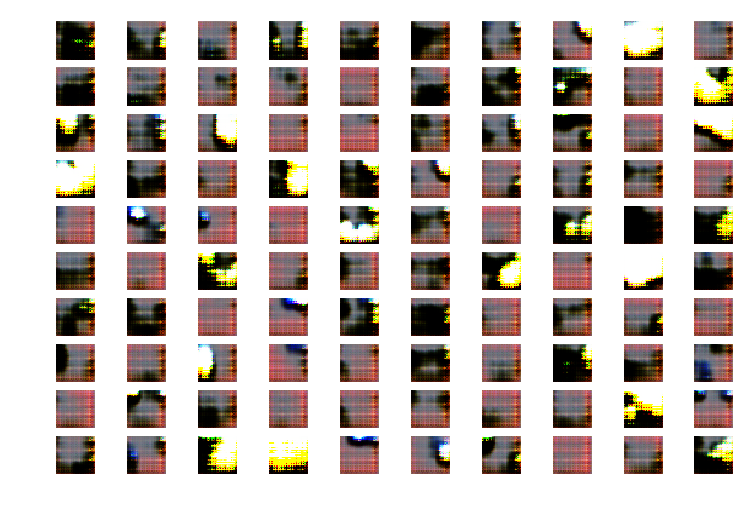

Training G...[loss_d: 0.4495/ loss_g: 0.4110]  41% |#   | Elapsed Time: 0:18:46

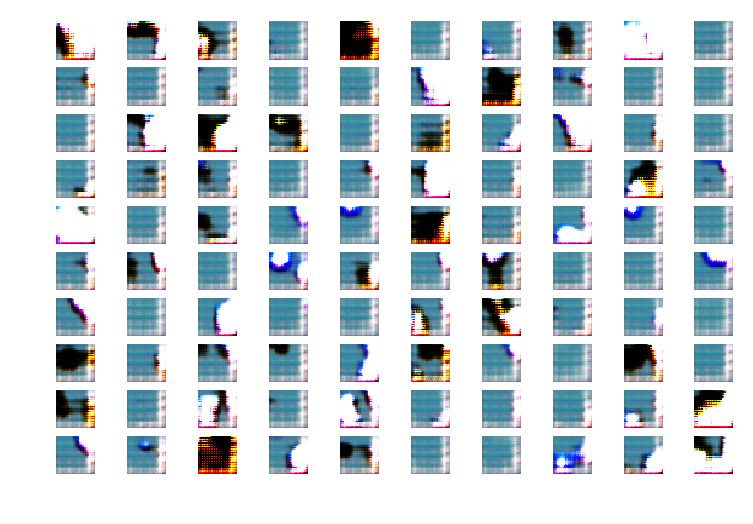

Training G...[loss_d: 0.4070/ loss_g: 0.4442]  42% |#   | Elapsed Time: 0:19:34

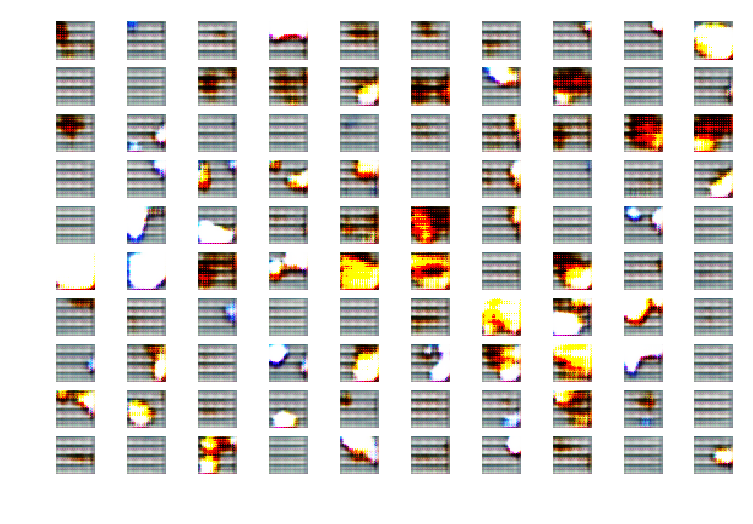

Training G...[loss_d: 0.4389/ loss_g: 0.5385]  44% |#   | Elapsed Time: 0:20:21

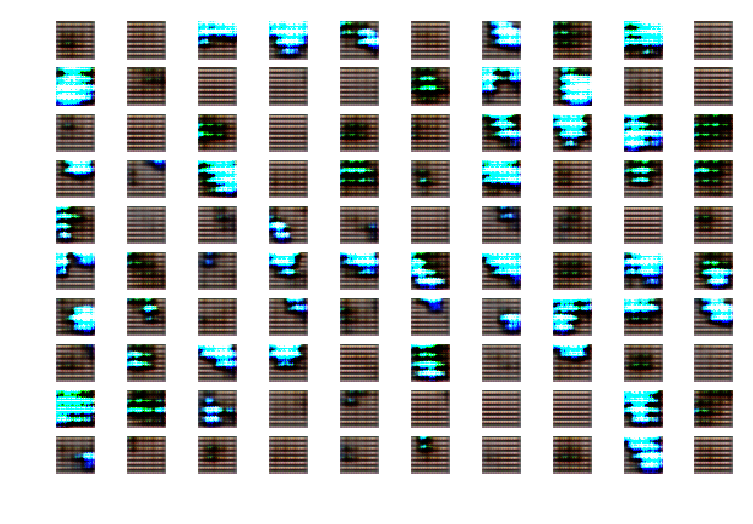

Training G...[loss_d: 0.5281/ loss_g: 0.4565]  46% |#   | Elapsed Time: 0:21:08

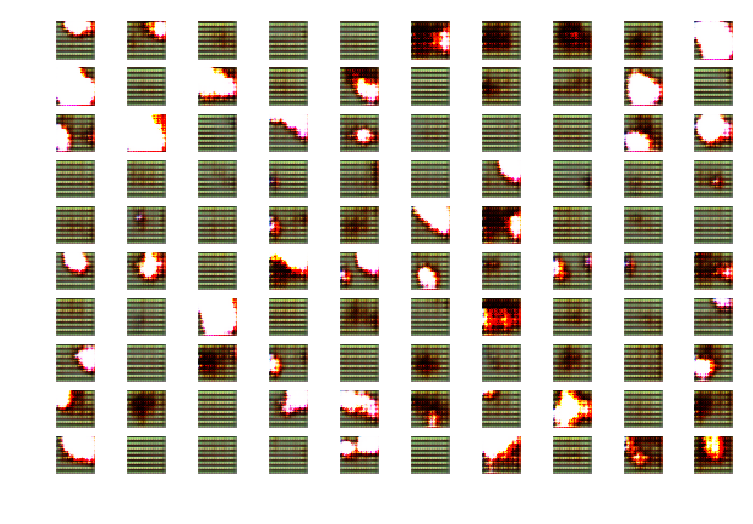

Training G...[loss_d: 0.4506/ loss_g: 0.5560]  48% |#   | Elapsed Time: 0:21:56

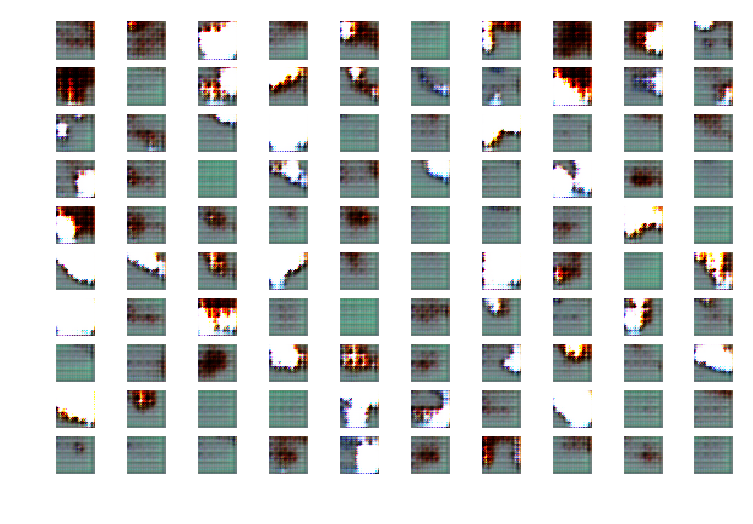

Training G...[loss_d: 0.5450/ loss_g: 0.4180]  49% |#   | Elapsed Time: 0:22:42

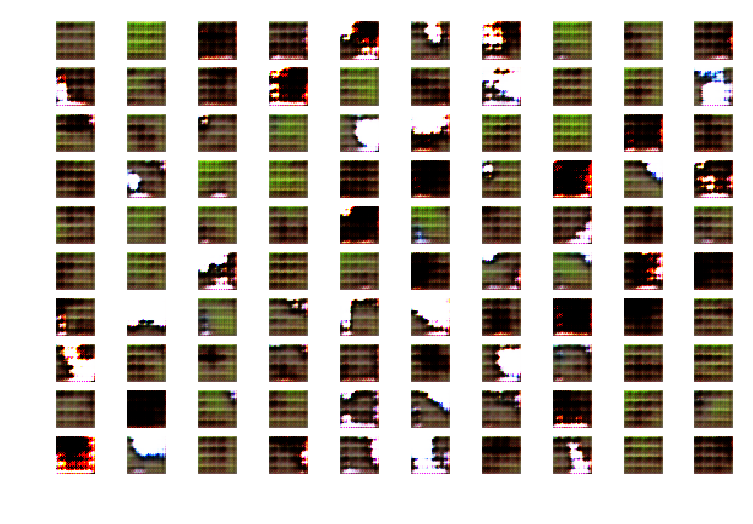

Training G...[loss_d: 0.4138/ loss_g: 0.4777]  51% |##  | Elapsed Time: 0:23:30

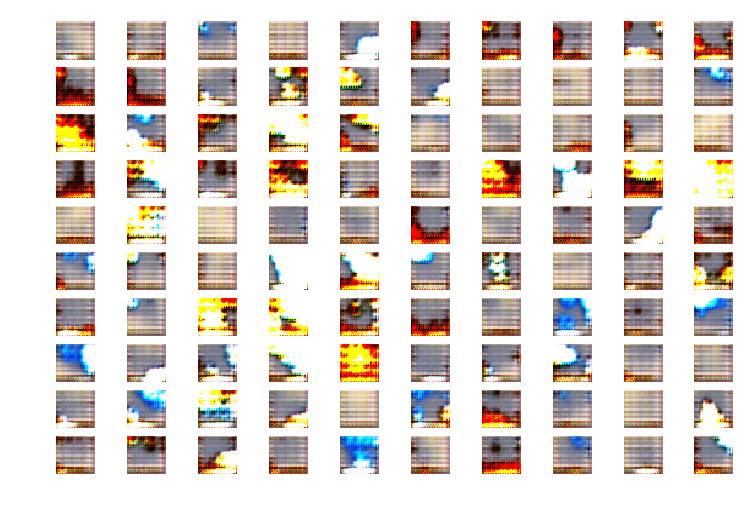

Training G...[loss_d: 0.4705/ loss_g: 0.6161]  53% |##  | Elapsed Time: 0:24:10

In [ ]:
display_loss()
h = epoch_mixed(ratio_d_per_g=0.7, 
                generator_step_size=30)

losses['g'] += h['g']
losses['d'] += h['d']

In [ ]:
epoch_mixed(ratio_d_per_g=0.5, 
            generator_step_size=30)

In [ ]:
def mixed_train(epoch=100):
    
    for i in range(epoch):
        # at the begining, train more the discriminator than the generator
        ratio = 
        step_size = 10
        
        h = epoch_mixed(ratio_d_per_g=0.7, 
                generator_step_size=30)

        losses['g'] += h['g']
        losses['d'] += h['d']